# GANs: Generative Adversarial Networks
- Autoencoders are "non-linear PCA"
    - *large dimension data space is reduced to small dimension from which can recreate data point in orginal data space*
- Variational Autoencoders (VAEs) add to thiis the variational estimation of the latent distrbution
    - *since the embedding is a distribution, latent distrbution can be (variationally estimated) matched to the distribution of embedding distributions*
    - **but since the latent distribution has now been estimated, we can sample from it to *simulate new data*:** 
    
    $$x \overset{encode}{\rightarrow} \underset{mvn}{Z} \overset{decode}{\rightarrow} \tilde x \quad \Longrightarrow \quad Z \sim mvn \overset{decode}{\rightarrow} \tilde x$$
    
- GANs: let's just start there: 
    $$Z \sim f \overset{generate}{\rightarrow} \tilde x$$
    - but how do we learn that "*generate*" function?

## The world according to $d$

***Wants to distringuish real and fake***

- $X\sim p_X$: real image
    - $p_X \longrightarrow p_{data}$
- $Z\sim p_Z$: noise
- $\tilde x=i(z)$: fake image (imitator, generator)
    - $i(p_Z) \longrightarrow p_{model}$



- $d(x)$ and $d(\tilde x)$: discriminator (bernoulli, yes/no)
    - $d(X)$ should be $1$ if $X\sim p_X$
        - $\textrm{E}_{X\sim p_X}\left[\log d(X)\right]$: should be $0$
    - $d(i(Z))$ should be $0$ if $Z\sim p_{Z}$
        - $\textrm{E}_{Z\sim p_Z}\left[\log d(i(Z))\right]$: should be $-\infty$
            - $\textrm{E}_{Z\sim p_Z}\left[\log (1-d(i(Z)))\right]$: should be $0$
            

These objectives can be pursued with
- $\underset{d}{\max}\quad \textrm{E}_{X\sim p_X}\left[\underset{\leq 0}{\underbrace{\log d(X)}}\right] + \textrm{E}_{Z\sim p_Z}\left[\underset{\leq 0}{\underbrace{\log (1-d(i(Z)))}}\right] $


As noted in the [Video Tutorial](https://www.youtube.com/watch?v=HGYYEUSm-0Q&t=2600s)
from [Exercise 7.1](https://arxiv.org/pdf/1701.00160.pdf) and as shown [elsewhere](https://srome.github.io/An-Annotated-Proof-of-Generative-Adversarial-Networks-with-Implementation-Notes/), the theoretically optimial discriminator rule is $d^*(x_0) = \frac{p_{data}(x_0)}{p_{data}(x_0)+p_{model}(x_0)}$.
- It's not that we're guaranteed to get this: it's just what this is doing ideally.
- So it's an *implicit* density model: it doesn't know $p_{data}$ or $p_{model}$, just their ratio


![density_ratio](https://wiki.math.uwaterloo.ca/statwiki/images/2/2c/figure1.jpg)
- `https://stats.stackexchange.com/questions/435140/how-to-understand-generative-adversarial-networks-discriminative-distribution`
- black dots data distribution
- green model model of data
- blue dotted line is the density ratio: flat line is at height 1/1
- Z down below is random noised that gets transformed into the model generated data



## The world according to $i$

***Wants to do the opposite, i.e., trick $d$***

- $d(i(Z))$ should be $1$ for $Z\sim p_Z$
    - $\textrm{E}_{Z\sim p_X}\left[\log d(i(Z))\right]$: should be $0$
        - $\textrm{E}_{Z\sim p_X}\left[\log (1-d(i(Z)))\right]$: should be $- \infty$
        
This objective can be pursued with

- $\underset{i}{\min} \textrm{E}_{Z\sim p_Z}\left[\underset{\leq 0}{\underbrace{\log (1-d(i(Z)))}}\right]$

### Pursuing the interests of *both* $i$ AND $d$ is actually best described as a so-called "minimax game" 

1. Solutions here are "(Nash) equilibria" (as oppose to "local minima")
2. Steps in $d$ and $i$ towards an equilibrium can be updated "simultaneously" sequentially 

$\underset{i}{\min} \underset{d}{\max}\quad \textrm{E}_{X\sim p_X}\left[\underset{\leq 0}{\underbrace{\log d(X)}}\right] + \textrm{E}_{Z\sim p_Z}\left[\underset{\leq 0}{\underbrace{\log (1-d(i(Z)))}}\right]$

- However, the generator $i$ loss function saturates (as shown in the figure below) when the discriminator correctly calls a generator image: $d(i(Z))=0$
    - To satisfy $i$, we're better off just maximizing $\textrm{E}_{Z\sim p_Z}\left[\log d(i(Z))\right]$
        - rather than messing with trying to minimize the "one minus" formulation that the $d$ likes
            - **So we don't actually use the *minimax* form for the $i$ side of things, just for the $d$ side**

Theoretically, the whole process stops when $d(X)$ and $d(i(Z))$ are indistinguishable under $X\sim p_X$ and $Z\sim p_Z$ (i.e., "(d)" in the image above)

![](https://danieltakeshi.github.io/assets/goodfellow_gradients.png)
- `https://danieltakeshi.github.io/2017/03/05/understanding-generative-adversarial-networks/`


# Data V1
- MNIST with `as_supervised=False` gives us (x,x) as opposed to (x,y)
       

In [3]:
import tensorflow as tf
import tensorflow_datasets as tfds

datasets, datasets_info = tfds.load(name='mnist', with_info=True,
                                    as_supervised=False) # this gives us (x,x) as opposed to (x,y)


- no (digit) labels
- no [0,1] standardized, as in: https://www.tensorflow.org/probability/examples/Probabilistic_Layers_VAE

In [4]:
# https://www.tensorflow.org/probability/examples/Probabilistic_Layers_VAE

def _preprocess(sample):
    image = tf.cast(sample['image'], tf.float32) / 255.  # Scale to unit interval.
    #image = image < tf.random.uniform(tf.shape(image))  # Randomly binarize.
    return image, image

batch_size = 32
BUFFER_SIZE = 60000
train_dataset = (datasets['train']
                 .map(_preprocess)
                 .shuffle(BUFFER_SIZE)
                 .batch(batch_size, drop_remainder=True)
                 .prefetch(tf.data.experimental.AUTOTUNE))
eval_dataset = (datasets['test']
                .map(_preprocess)
                .batch(batch_size, drop_remainder=True)
                .prefetch(tf.data.experimental.AUTOTUNE))


# V1 (Plain GAN)
- But with Scaled Exponential Linear Unit `selu` ("SElf normalizing" Linear Unit)
    - $\alpha \approx 1.6732, \lambda \approx  1.0507$

$$ELU(x) =  \left\{\begin{array}{lr}x&\textrm{if }x \geq 0\\
                         \alpha e^x-\alpha&\textrm{if }x \leq 0\end{array}\right. $$
$$SELU(x) = \lambda \left\{\begin{array}{lr}x&\textrm{if }x \geq 0\\
                         \alpha e^x-\alpha&\textrm{if }x \leq 0\end{array}\right. $$

- `https://mlfromscratch.com/activation-functions-explained/`
- `https://towardsdatascience.com/gentle-introduction-to-selus-b19943068cd9`
- `https://towardsdatascience.com/selu-make-fnns-great-again-snn-8d61526802a9`


**The authors were able to show that (for specific weight distribution initializations) the gradients on the weights induced by this activation function will serve to update weights such that the activations tend to "self-normalize" (with mean 0 and standard deviation 1):**

- It shrinks the "spread" towards standard deviation 1
- It pulls left/right leaning weight distributions towards 0
- *So it does those, PLUS the nonlinearity that we need*


|ELU|SELU|
|:-:|:-:|
|![ELU](https://mlfromscratch.com/content/images/2019/12/elu.png)|![SELU](https://mlfromscratch.com/content/images/2019/12/relu--7--1.png)|

- `https://mlfromscratch.com/activation-functions-explained/`

# Generator

In [5]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Reshape

embedding_dimension = 30
# we will sample a random variable of the above dimension
# and then transform it through the generator into a 28x28 image as below
generator = Sequential([
                        Dense(32, kernel_initializer='lecun_normal', use_bias=True,
                              activation='selu', input_shape=[embedding_dimension]),
                        
                        Dense(64, kernel_initializer='lecun_normal', 
                              use_bias=True, activation='selu'),
                        
                        Dense(28*28, activation='sigmoid'),
                        Reshape([28,28,1])],
                       
                       name='generator')

generator.summary()


Model: "generator"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 32)                992       
_________________________________________________________________
dense_1 (Dense)              (None, 64)                2112      
_________________________________________________________________
dense_2 (Dense)              (None, 784)               50960     
_________________________________________________________________
reshape (Reshape)            (None, 28, 28, 1)         0         
Total params: 54,064
Trainable params: 54,064
Non-trainable params: 0
_________________________________________________________________


# Discriminator

In [6]:
from tensorflow.keras.layers import Flatten

discriminator = Sequential([Flatten(input_shape=[28,28]), 
                            
                            Dense(64, kernel_initializer='lecun_normal',
                                  activation='selu', use_bias=True),
                            
                            Dense(32, kernel_initializer='lecun_normal',
                                  activation='selu', use_bias=True),
                            
                            Dense(1, activation='sigmoid')],
                           name='discriminator')
discriminator.summary()


Model: "discriminator"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
flatten (Flatten)            (None, 784)               0         
_________________________________________________________________
dense_3 (Dense)              (None, 64)                50240     
_________________________________________________________________
dense_4 (Dense)              (None, 32)                2080      
_________________________________________________________________
dense_5 (Dense)              (None, 1)                 33        
Total params: 52,353
Trainable params: 52,353
Non-trainable params: 0
_________________________________________________________________


# GAN

In [7]:
gan = Sequential([generator, discriminator])
gan.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
generator (Sequential)       (None, 28, 28, 1)         54064     
_________________________________________________________________
discriminator (Sequential)   (None, 1)                 52353     
Total params: 106,417
Trainable params: 106,417
Non-trainable params: 0
_________________________________________________________________


In [8]:
[i.name for i in gan.trainable_variables]

['dense/kernel:0',
 'dense/bias:0',
 'dense_1/kernel:0',
 'dense_1/bias:0',
 'dense_2/kernel:0',
 'dense_2/bias:0',
 'dense_3/kernel:0',
 'dense_3/bias:0',
 'dense_4/kernel:0',
 'dense_4/bias:0',
 'dense_5/kernel:0',
 'dense_5/bias:0']

- Fitting: we alternate `discriminator`/`generator` updates
    - as opposed to the simultaneous updates [described here](https://www.activestate.com/blog/how-to-build-a-generative-adversarial-network-gan/) (which are actually the Ian Goodfellow recommendation)


1. We need to set our `loss` functions
    1. `discriminator`: "minimax" (i.e., the max part of it)
    2. `generator`: heuristic 
2. We need to "freeze" `discriminator` parameters when training `generator`



In [9]:
# binary_crossentropy with true/1's and fake/0's
discriminator.compile(loss='binary_crossentropy', 
                      optimizer=tf.keras.optimizers.Adam(1e-3),#'rmsprop',
                      metrics=['binary_accuracy'])


- The "minimax" version from the perspective of the discriminator $d$ is just bernoulli cross-entropy:

$
\begin{align*}
\displaystyle
\log \prod_j p_j^{y_j}(1-p_j)^{(1-y_j)} \approx {} & \log p^{\sum_j y_j}(1-p)^{(n-\sum_j y_j)}\\
\approx {} & \log d(X)^{n_{real}} + \log (1-d(i(Z)))^{n_{fake}}\\
\approx {} & \log \prod_j d(X_j)^{1(j_{real})}(1-d(i(Z_j)))^{1(j_{fake})}
\end{align*}
$

In [10]:
# this needs to be set before compiling the gan!
# I think so that the TF compute graph doesn't include these in backprop
discriminator.trainable = False

[i.name for i in gan.trainable_variables]


['dense/kernel:0',
 'dense/bias:0',
 'dense_1/kernel:0',
 'dense_1/bias:0',
 'dense_2/kernel:0',
 'dense_2/bias:0']

In [11]:
# binary_crossentropy for only fake/1's!!!
# This is the heuristic approach!  
# ... not the minimax game for zero-sum loss   
gan.compile(loss='binary_crossentropy', 
            optimizer=tf.keras.optimizers.Adam(1e-3))#'rmsprop')


- if we just treat the *fake* as "real" for the generator, then we can avoid the "minimax" form 
    - which saturates unhelpfully when learning the generator
    - so we can instead use the simpler "direct" form, which is then again just a bernoulli cross-entropy

$
\begin{align*}
\displaystyle
\log \prod_j d(i(Z_j))^{1(j_{fake})} = & {} \log \prod_j d(i(Z_j))^{1(j_{fake})} (1-d(X_j))^{1(j_{real})} \\
\end{align*}
$
**if there are no *real* examples**




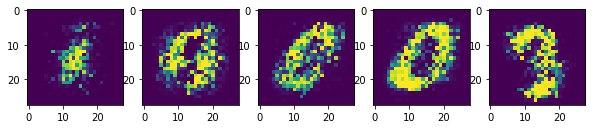

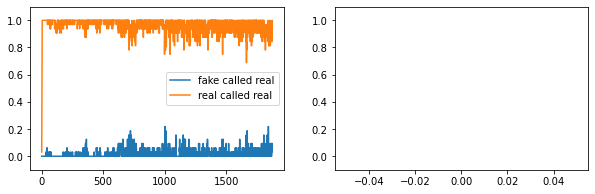

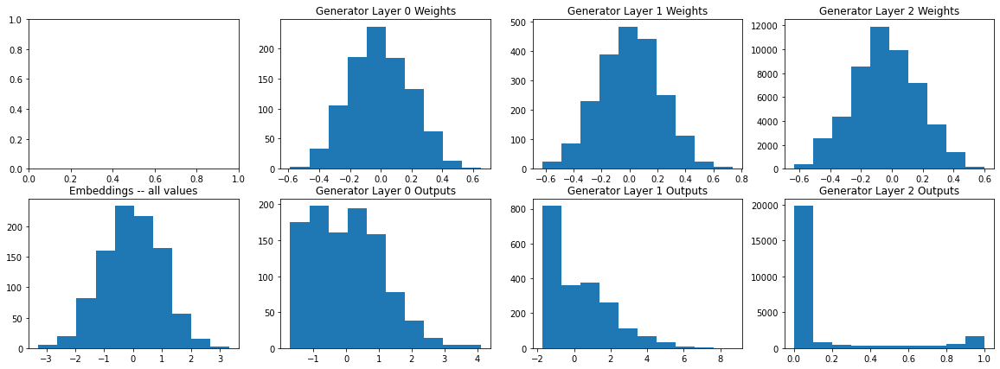

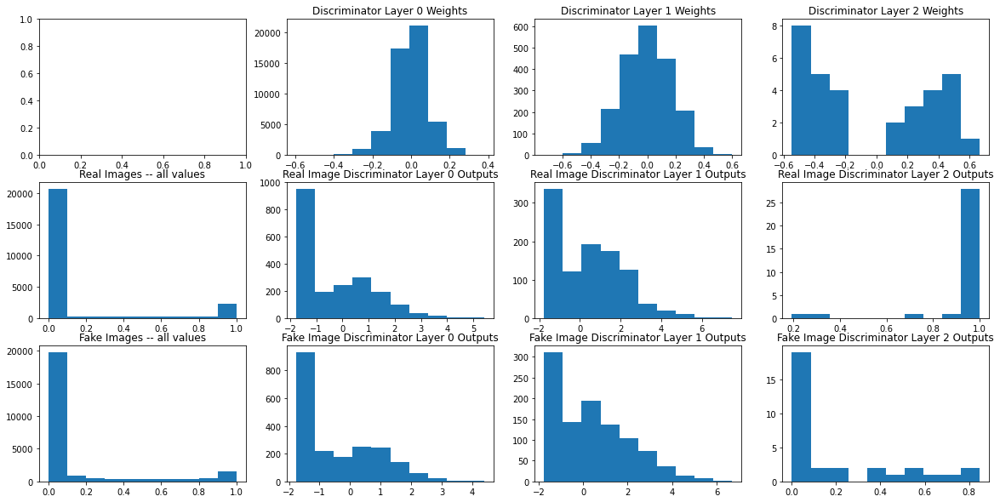

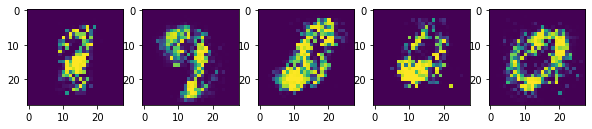

...

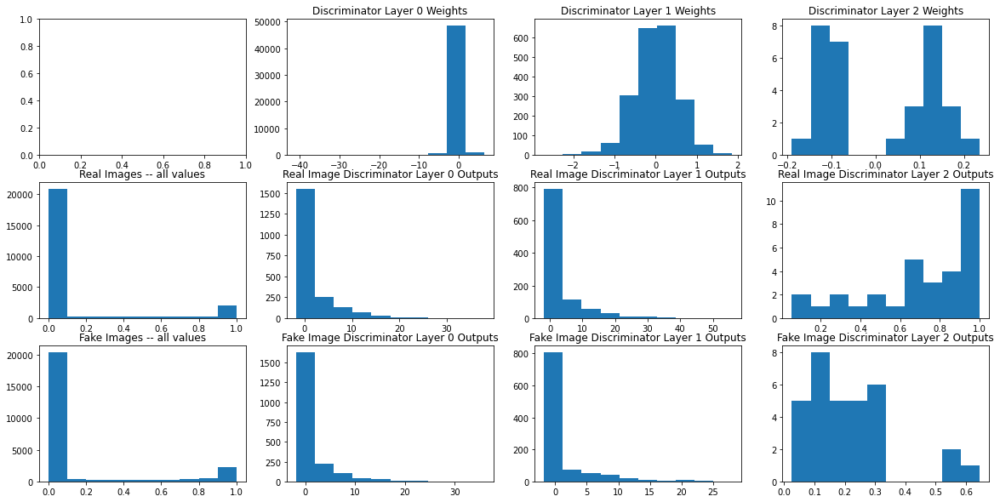

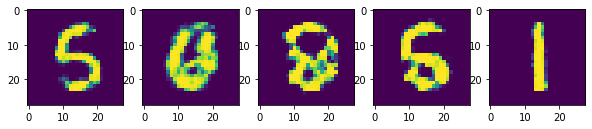

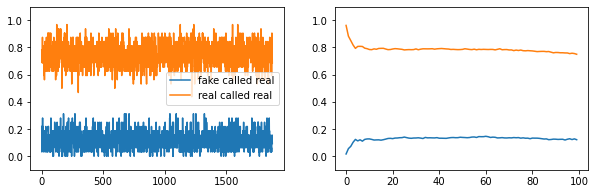

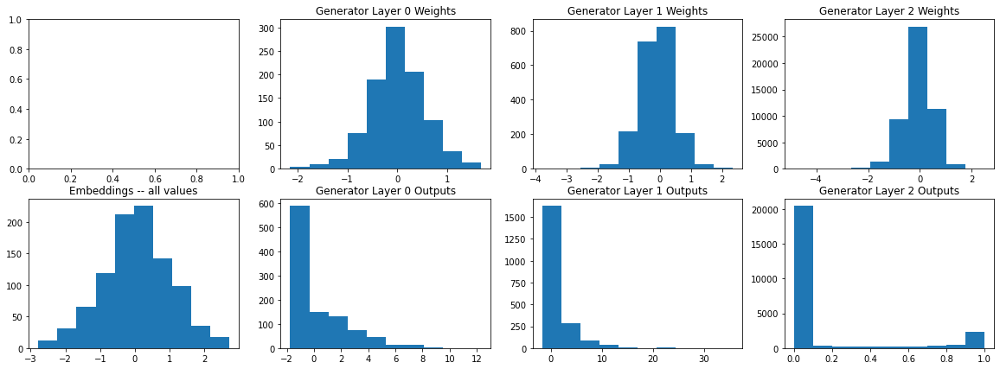

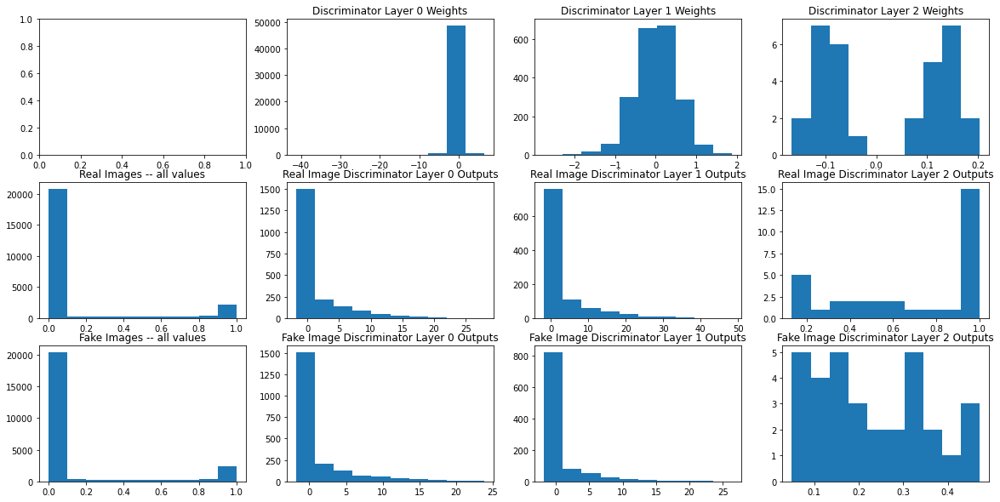

In [12]:
import matplotlib.pyplot as plt
import numpy as np
from tensorflow.keras.models import Model

# EPOCH LOOP with some tracking
number_epochs = 100
true_acc_ave,fake_acc_ave = [],[]
for epoch in range(number_epochs):
    
    # BATCHES LOOP with some tracking
    dis_loss,gan_loss = [],[]
    true_acc,fake_acc = [],[]
    for X,x in train_dataset:
        
        # GENERATOR STARTS WITH "NOISE"
        random_embedding = tf.random.normal([batch_size, embedding_dimension])
        tildeX = generator(random_embedding)
        # DISCRIMINATOR KNOWS THESE AS 0'S (FAKES)
        tildeY = [[0.]]*batch_size
        
        # REAL IMAGES ADDED
        X_tildeX = tf.concat([X, tildeX], axis=0)
        # DISCRIMINATOR KNOWS THESE AS 1'S (REALS)
        Y = [[1.]]*batch_size
        Y_tildeY = tf.constant(Y+tildeY)
        Y = tf.constant(Y)
        
        # TRAIN DISCRIMINATOR
        discriminator.trainable = True
        discriminator.train_on_batch(X_tildeX, Y_tildeY)
        # we actually alternate, as opposed to: https://www.activestate.com/blog/how-to-build-a-generative-adversarial-network-gan/

        # DISCRIMINATOR PERFORMANCE
        fake_acc += [(discriminator(tildeX)>0.5).numpy().sum()/batch_size]
        true_acc += [(discriminator(X)>0.5).numpy().sum()/batch_size]

        # GENERATOR STARTS WITH "NOISE"
        random_embedding = tf.random.normal([batch_size, embedding_dimension])
        # GENERATOR (WITH FROZEN DISCRIMINATOR) KNOWS THESE FAKES AS 1'S (REALS)
        discriminator.trainable = False
        gan_loss += [gan.train_on_batch(random_embedding, Y)]
        # we actually alternate, as opposed to: https://www.activestate.com/blog/how-to-build-a-generative-adversarial-network-gan/

    # DIAGNOSTIC PLOTS DESCRIBED BELOW
    fig,ax = plt.subplots(1,5, figsize=(10,10))
    ax = ax.flatten()
    for i in range(5):
        ax[i].imshow(generator(random_embedding).numpy() [i,...,0])
    plt.show()
    
    fig,ax = plt.subplots(1,2, figsize=(10,3))
    ax = ax.flatten()
    ax[0].plot(fake_acc, label='fake called real')
    ax[0].plot(true_acc, label='real called real')
    ax[0].set_ylim([-0.1,1.1])
    ax[0].legend()
    true_acc_ave += [np.mean(true_acc)]
    fake_acc_ave += [np.mean(fake_acc)]
    ax[1].plot(fake_acc_ave, label='fake called real')
    ax[1].plot(true_acc_ave, label='real called real')
    ax[1].set_ylim([-0.1,1.1])
    plt.show()
    
    # DIAGNOSTIC PLOTS DESCRIBED BELOW        
    fig,ax = plt.subplots(2,4, figsize=(20,7))
    ax = ax.flatten()    
    ax[4].hist(random_embedding.numpy().flatten())
    ax[4].set_title('Embeddings -- all values')
    for i in range(3):
        ax[i+1].hist(generator.layers[i].weights[0].numpy().flatten())
        ax[i+1].set_title('Generator Layer '+str(i)+' Weights')
    for i in range(3):
        generator_layer_output = Model(generator.input, generator.layers[i].output)
        ax[i+5].hist(generator_layer_output(random_embedding).numpy().flatten())
        ax[i+5].set_title('Generator Layer '+str(i)+' Outputs')
    plt.show()

    # DIAGNOSTIC PLOTS DESCRIBED BELOW
    fig,ax = plt.subplots(3,4, figsize=(20,10))
    ax = ax.flatten()
    ax[4].hist(X.numpy().flatten())
    ax[4].set_title('Real Images -- all values')
    ax[8].hist(generator(random_embedding).numpy().flatten())
    ax[8].set_title('Fake Images -- all values')
    for i in range(3):
        ax[i+1].hist(discriminator.layers[i+1].weights[0].numpy().flatten())
        ax[i+1].set_title('Discriminator Layer '+str(i)+' Weights')
    for i in range(3):        
        discriminator_layer_output = Model(discriminator.input, discriminator.layers[i+1].output)
        ax[i+5].hist(discriminator_layer_output(X).numpy().flatten())
        ax[i+5].set_title('Real Image Discriminator Layer '+str(i)+' Outputs')
        tmp = discriminator_layer_output(generator(random_embedding))
        ax[i+9].hist(tmp.numpy().flatten())
        ax[i+9].set_title('Fake Image Discriminator Layer '+str(i)+' Outputs')
    plt.show()


1. We want the numbers to look good
2. We want the prediction probabilities to both meet at 50%
3. Using `SELU` we'd like to see the activations (and hence weights) staying fairly "standardized"

I print out
1. 5 examples
2. (1) % "real" calls per batch (for both reals and fakes) and (2) % "real" calls per epoch (for both reals and fakes)
3. Weights/Activations
    1. Generator 
        1. noise (embedding) -> next layer activations -> next layer activations -> output layer output (image)
        2. above each layer activation are the layer weights
    
    2. Discriminator    
        1. real/fake images -> next layer activations -> next layer activations -> output layer output (percent real)
        2. above each layer activation are the layer weights





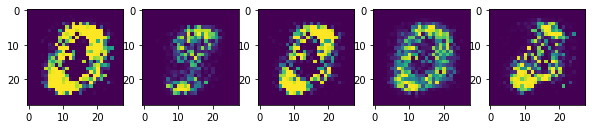

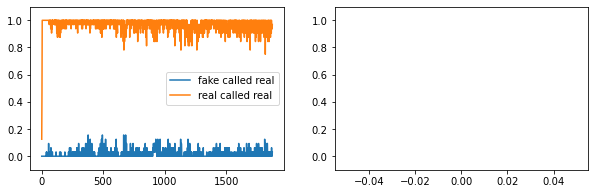

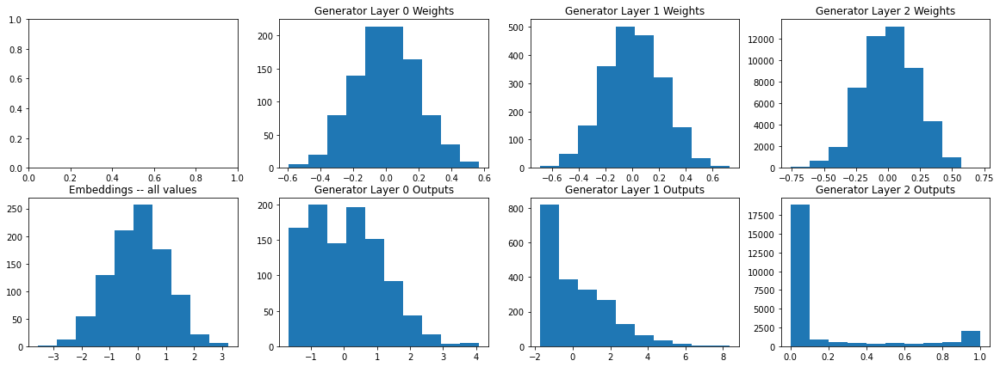

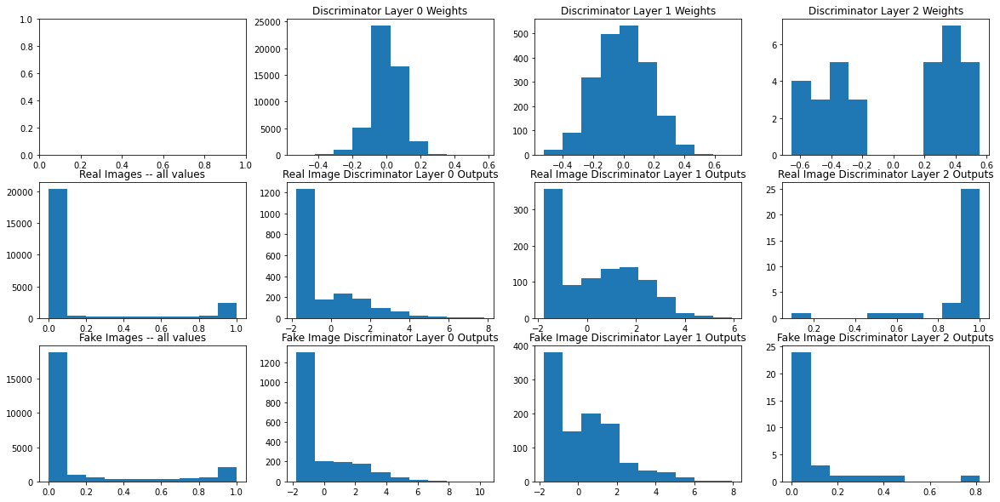

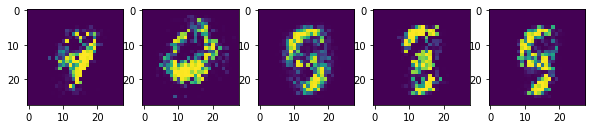

...

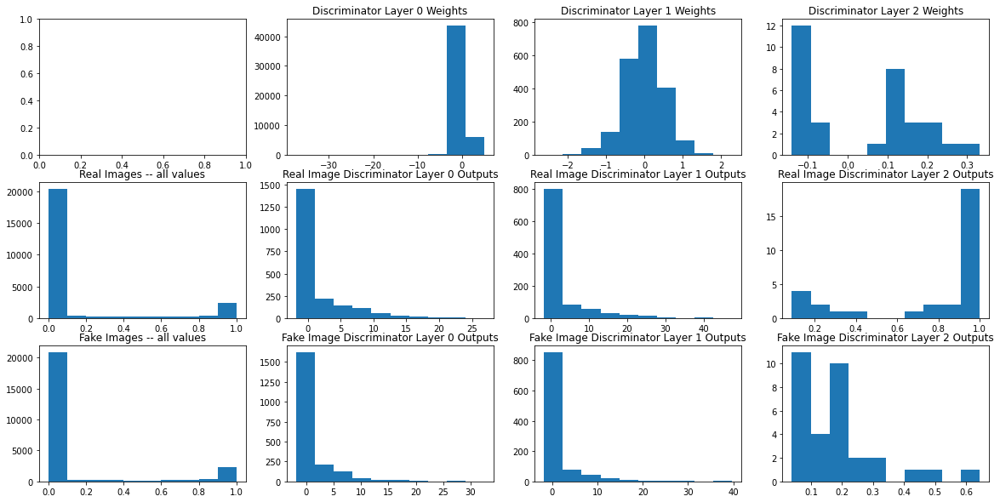

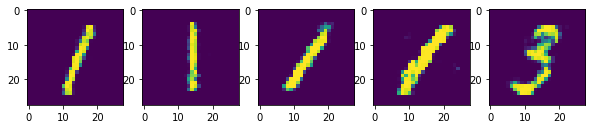

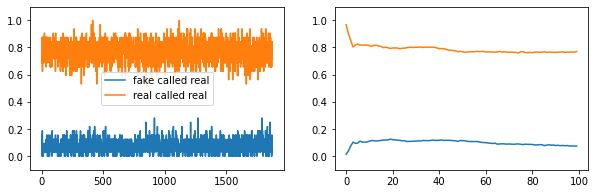

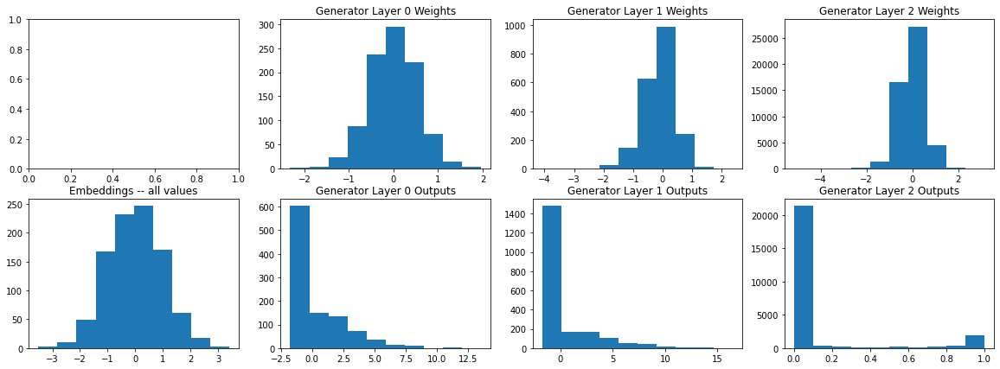

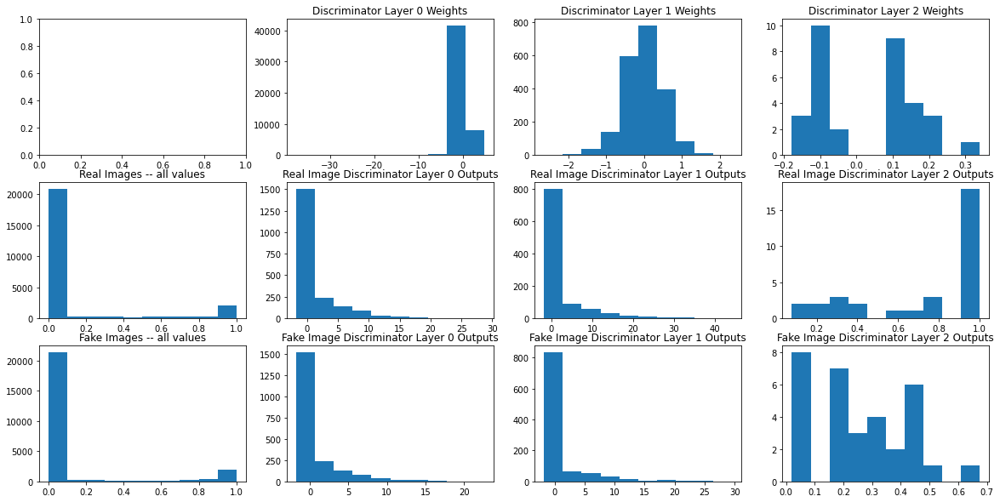

In [434]:

number_epochs = 100

true_acc_ave,fake_acc_ave = [],[]
for epoch in range(number_epochs):
    dis_loss,gan_loss = [],[]
    true_acc,fake_acc = [],[]
    
    for X,x in train_dataset:
        
        random_embedding = tf.random.normal([batch_size, embedding_dimension])
        tildeX = generator(random_embedding)
        tildeY = [[0.]]*batch_size
        
        Y = [[1.]]*batch_size
        X_tildeX = tf.concat([X, tildeX], axis=0)
        Y_tildeY = tf.constant(Y+tildeY)
        Y = tf.constant(Y)
        discriminator.trainable = True
        discriminator.train_on_batch(X_tildeX, Y_tildeY)
        # we actually alternate, as opposed to: https://www.activestate.com/blog/how-to-build-a-generative-adversarial-network-gan/

        fake_acc += [(discriminator(tildeX)>0.5).numpy().sum()/batch_size]
        true_acc += [(discriminator(X)>0.5).numpy().sum()/batch_size]

        discriminator.trainable = False
        # gan.metrics_names
        random_embedding = tf.random.normal([batch_size, embedding_dimension])
        gan_loss += [gan.train_on_batch(random_embedding, Y)]
        # we actually alternate, as opposed to: https://www.activestate.com/blog/how-to-build-a-generative-adversarial-network-gan/

    fig,ax = plt.subplots(1,5, figsize=(10,10))
    ax = ax.flatten()
    for i in range(5):
        ax[i].imshow(generator(random_embedding).numpy() [i,...,0])
    plt.show()
    
    fig,ax = plt.subplots(1,2, figsize=(10,3))
    ax = ax.flatten()
    ax[0].plot(fake_acc, label='fake called real')
    ax[0].plot(true_acc, label='real called real')
    ax[0].set_ylim([-0.1,1.1])
    ax[0].legend()
    true_acc_ave += [np.mean(true_acc)]
    fake_acc_ave += [np.mean(fake_acc)]
    ax[1].plot(fake_acc_ave, label='fake called real')
    ax[1].plot(true_acc_ave, label='real called real')
    ax[1].set_ylim([-0.1,1.1])
    plt.show()
        
    fig,ax = plt.subplots(2,4, figsize=(20,7))
    ax = ax.flatten()    
    ax[4].hist(random_embedding.numpy().flatten())
    ax[4].set_title('Embeddings -- all values')
    for i in range(3):
        ax[i+1].hist(generator.layers[i].weights[0].numpy().flatten())
        ax[i+1].set_title('Generator Layer '+str(i)+' Weights')
    for i in range(3):
        generator_layer_output = Model(generator.input, generator.layers[i].output)
        ax[i+5].hist(generator_layer_output(random_embedding).numpy().flatten())
        ax[i+5].set_title('Generator Layer '+str(i)+' Outputs')
    plt.show()


    fig,ax = plt.subplots(3,4, figsize=(20,10))
    ax = ax.flatten()
    ax[4].hist(X.numpy().flatten())
    ax[4].set_title('Real Images -- all values')
    ax[8].hist(generator(random_embedding).numpy().flatten())
    ax[8].set_title('Fake Images -- all values')
    for i in range(3):
        ax[i+1].hist(discriminator.layers[i+1].weights[0].numpy().flatten())
        ax[i+1].set_title('Discriminator Layer '+str(i)+' Weights')
    for i in range(3):
        discriminator_layer_output = Model(discriminator.input, discriminator.layers[i+1].output)
        ax[i+5].hist(discriminator_layer_output(X).numpy().flatten())
        ax[i+5].set_title('Real Image Discriminator Layer '+str(i)+' Outputs')
        tmp = discriminator_layer_output(generator(random_embedding))
        ax[i+9].hist(tmp.numpy().flatten())
        ax[i+9].set_title('Fake Image Discriminator Layer '+str(i)+' Outputs')
    plt.show()





# ^^^^^MODE COLLAPSE LOOKS LIKE A POTENTIAL ISSUE^^^^^

# DC-GANs: *Deep Convolutional ...*
- Swap in convolutional layers instead of dense layers
- Should let us save some parameters from a dense (wide) network and repurpose them for a deep network

![](https://paperswithcode.com/media/methods/Screen_Shot_2020-07-01_at_11.27.51_PM_IoGbo1i.png)

When you "convolve out" (i.e., grow up/up sample an image)
- you want to specify the "oppoosite" (i.e., transpose) of the usual forward "convolutional" layer
    - e.g., 4->10 $(4x10)$, 10->4 $(4x10)^T$
- Thus you use `Conv2DTranspose`
    - But/And it's parameterized to let you specify things from the forward direction
    
        So, e.g.,
        - last layer: we can make a 28x28 into a 14x14 with a 5x5 kernel and `padding='same'` and `strides=2`
            - *so that's the parameterization we use to "reverse/undo" 14x14 back to 28x28*
        - third layer: we can make a 7x7x32 into a 7x7x64 from a (64 filter) 5x5 kernel and `padding='same'` and `strides=1`        

    
- And then keep those connections and just flip/reverse the order of the layers

    - So, rather than the "usual forward direction" where a kernel produce a single neuron activation
    - the "reverse" happens: the neuron projects out the kernel which produces the "upsample" (controlled by the single neuron)
    
   


<br><br>

|||
|-|-|
|<img style="transform: rotate(-90deg); width:300px" src="https://miro.medium.com/max/1400/1*yoQ62ckovnGYV2vSIq9q4g.gif" />|<img style="transform: rotate(90deg); width:300px" src="https://miro.medium.com/max/1972/1*kOThnLR8Fge_AJcHrkR3dg.gif" />|

<br><br>


(https://medium.com/apache-mxnet/transposed-convolutions-explained-with-ms-excel-52d13030c7e8)

(*strides not shown in the above)

- Instead of "convoluting down", you "grow upwards": same connections, just opposite layer order
- This is the most computationally efficient approach to "reverse/undo convolutions"
        



In [13]:
# https://www.tensorflow.org/tutorials/generative/dcgan

from tensorflow.keras.layers import Conv2DTranspose

dc_generator = Sequential([
                           Dense(7*7*64, activation='selu', use_bias=True, 
                                 kernel_initializer='lecun_normal',
                                 input_shape=[embedding_dimension]),
                           Reshape((7, 7, 64)),
    
                           Conv2DTranspose(32, 5, strides=1, kernel_initializer='lecun_normal',
                                           padding='same', use_bias=True, activation='selu'),
                           Conv2DTranspose(16, 5, strides=2, kernel_initializer='lecun_normal',
                                           padding='same', use_bias=True, activation='selu'),
                           Conv2DTranspose(1, 5, strides=2, kernel_initializer='lecun_normal',
                                           padding='same', use_bias=True, activation='sigmoid')],
                          name='dc_generator')

dc_generator.summary()


Model: "dc_generator"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_6 (Dense)              (None, 3136)              97216     
_________________________________________________________________
reshape_1 (Reshape)          (None, 7, 7, 64)          0         
_________________________________________________________________
conv2d_transpose (Conv2DTran (None, 7, 7, 32)          51232     
_________________________________________________________________
conv2d_transpose_1 (Conv2DTr (None, 14, 14, 16)        12816     
_________________________________________________________________
conv2d_transpose_2 (Conv2DTr (None, 28, 28, 1)         401       
Total params: 161,665
Trainable params: 161,665
Non-trainable params: 0
_________________________________________________________________


In [14]:
# https://www.tensorflow.org/tutorials/generative/dcgan
# https://github.com/bioinf-jku/SNNs/blob/master/Keras-CNN/MNIST-Conv-SELU.py
# https://www.tensorflow.org/api_docs/python/tf/keras/layers/AlphaDropout

from tensorflow.keras.layers import Conv2D, AlphaDropout

dc_discriminator = Sequential([
                               Conv2D(32, 5, strides=2, padding='same', use_bias=True, 
                                      kernel_initializer='lecun_normal',
                                      activation='selu', input_shape=[28, 28, 1]),
                               AlphaDropout(0.25), # different dropout variant required when using 'selu'
    
                               Conv2D(64, 5, strides=2, padding='same', use_bias=True, 
                                      kernel_initializer='lecun_normal',
                                      activation='selu'),
                               AlphaDropout(0.25), # different dropout variant required when using 'selu'      
                               Flatten(),
    
                               Dense(1, activation='sigmoid')],
                              name='dc_discriminator')

dc_discriminator.summary()


Model: "dc_discriminator"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 14, 14, 32)        832       
_________________________________________________________________
alpha_dropout (AlphaDropout) (None, 14, 14, 32)        0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 7, 7, 64)          51264     
_________________________________________________________________
alpha_dropout_1 (AlphaDropou (None, 7, 7, 64)          0         
_________________________________________________________________
flatten_1 (Flatten)          (None, 3136)              0         
_________________________________________________________________
dense_7 (Dense)              (None, 1)                 3137      
Total params: 55,233
Trainable params: 55,233
Non-trainable params: 0
______________________________________________

- Same setup as before with the non-saturating heuristic loss for the `generator`

In [15]:
gan = Sequential([dc_generator, dc_discriminator])
gan.summary()

# this needs to be compiled first!
dc_discriminator.compile(loss='binary_crossentropy', 
                         optimizer=tf.keras.optimizers.Adam(1e-4),
                      metrics=['binary_accuracy'])
# this needs to be set before compiling the gan!
dc_discriminator.trainable = False

        
gan.compile(loss='binary_crossentropy', 
            optimizer=tf.keras.optimizers.Adam(1e-4))


Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dc_generator (Sequential)    (None, 28, 28, 1)         161665    
_________________________________________________________________
dc_discriminator (Sequential (None, 1)                 55233     
Total params: 216,898
Trainable params: 216,898
Non-trainable params: 0
_________________________________________________________________


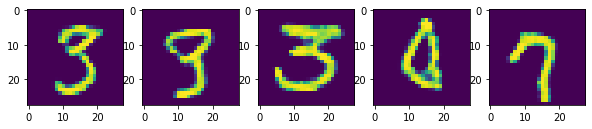

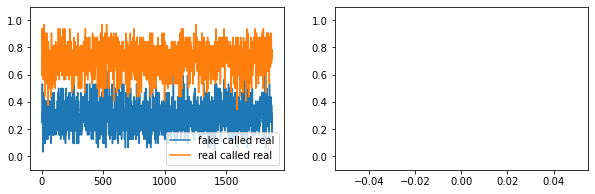

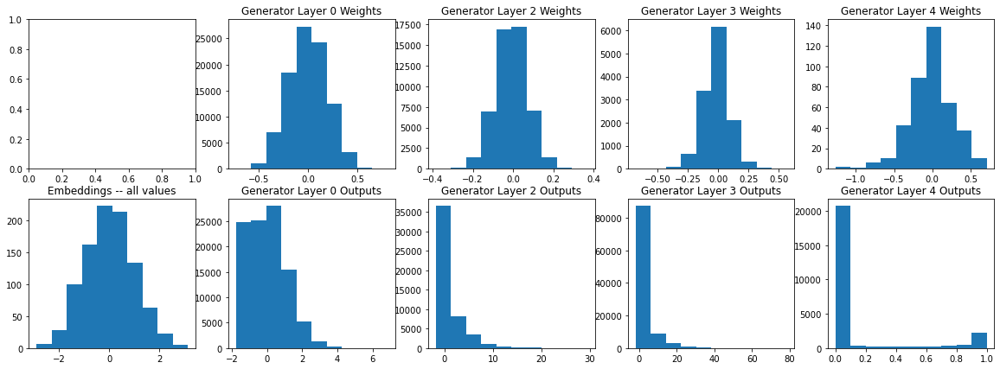

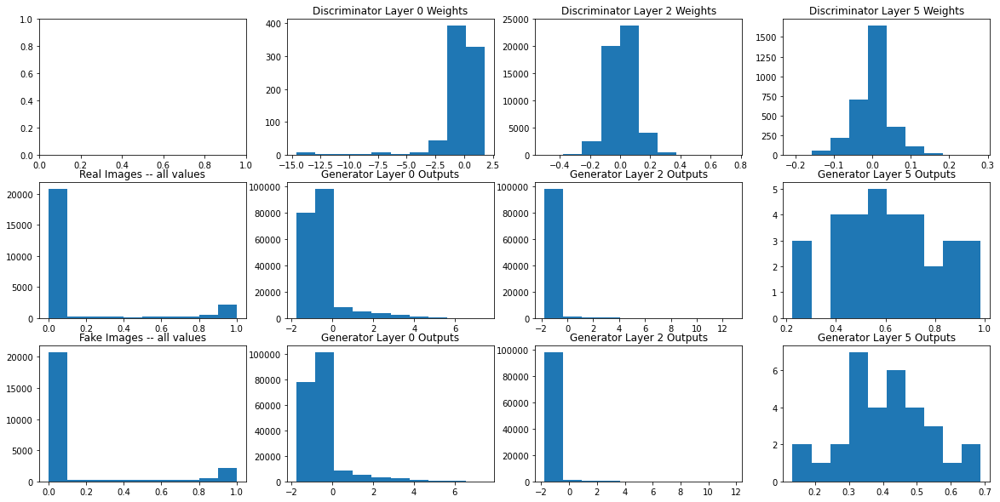

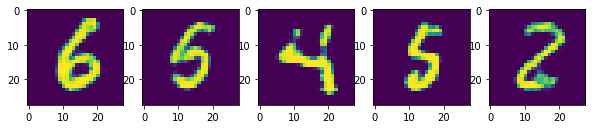

...

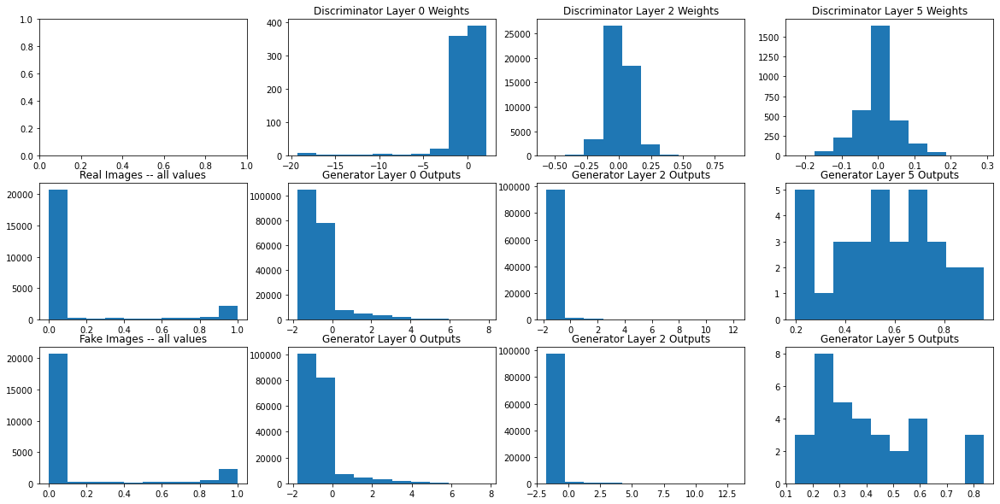

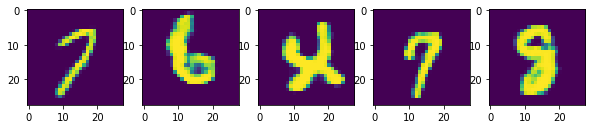

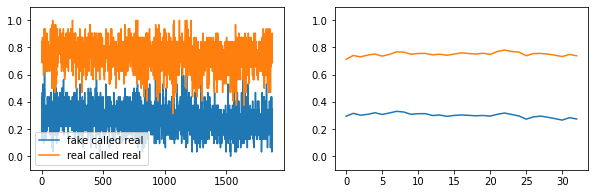

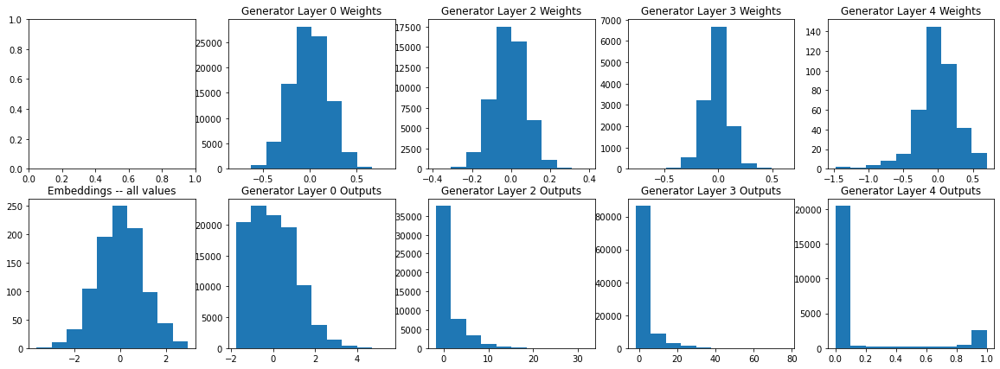

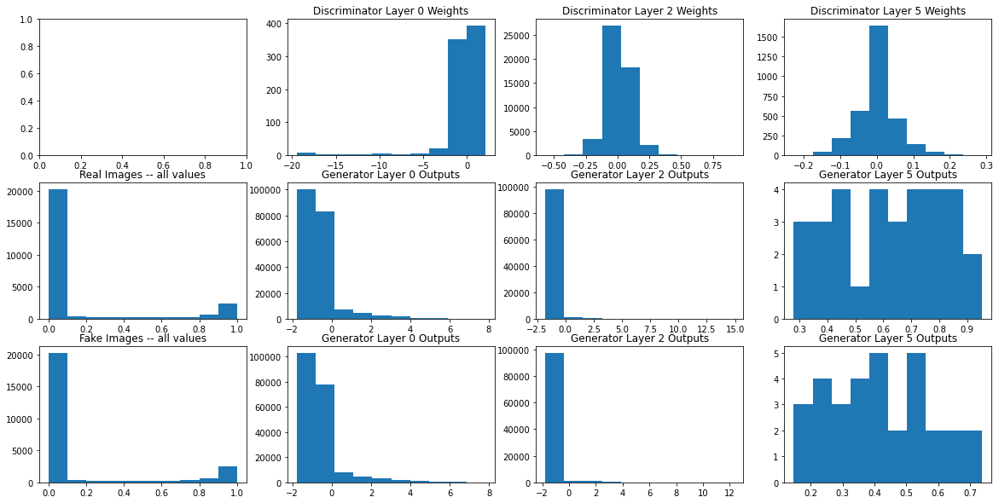

KeyboardInterrupt: 

In [17]:
number_epochs = 100

true_acc_ave,fake_acc_ave = [],[]
for epoch in range(number_epochs):
    dis_loss,gan_loss = [],[]
    true_acc,fake_acc = [],[]
    
    for X,x in train_dataset:
        
        random_embedding = tf.random.normal([batch_size, embedding_dimension])
        tildeX = dc_generator(random_embedding)
        tildeY = [[0.]]*batch_size
        
        Y = [[1.]]*batch_size
        X_tildeX = tf.concat([X, tildeX], axis=0)
        Y_tildeY = tf.constant(Y+tildeY)
        Y = tf.constant(Y)
        dc_discriminator.trainable = True
        dc_discriminator.train_on_batch(X_tildeX, Y_tildeY)
        # we actually alternate, as opposed to: https://www.activestate.com/blog/how-to-build-a-generative-adversarial-network-gan/


        fake_acc += [(dc_discriminator(tildeX)>0.5).numpy().sum()/batch_size]
        true_acc += [(dc_discriminator(X)>0.5).numpy().sum()/batch_size]

        dc_discriminator.trainable = False
        # gan.metrics_names
        random_embedding = tf.random.normal([batch_size, embedding_dimension])
        gan_loss += [gan.train_on_batch(random_embedding, Y)]
        # we actually alternate, as opposed to: https://www.activestate.com/blog/how-to-build-a-generative-adversarial-network-gan/


    fig,ax = plt.subplots(1,5, figsize=(10,10))
    ax = ax.flatten()
    for i in range(5):
        ax[i].imshow(dc_generator(random_embedding).numpy() [i,...,0])
    plt.show()
    fig,ax = plt.subplots(1,2, figsize=(10,3))
    ax = ax.flatten()
    ax[0].plot(fake_acc, label='fake called real')
    ax[0].plot(true_acc, label='real called real')
    ax[0].set_ylim([-0.1,1.1])
    ax[0].legend()
    true_acc_ave += [np.mean(true_acc)]
    fake_acc_ave += [np.mean(fake_acc)]
    ax[1].plot(fake_acc_ave, label='fake called real')
    ax[1].plot(true_acc_ave, label='real called real')
    ax[1].set_ylim([-0.1,1.1])
    plt.show()
        
    fig,ax = plt.subplots(2,5, figsize=(20,7))
    ax = ax.flatten()    
    ax[1].hist(dc_generator.layers[0].weights[0].numpy().flatten())
    ax[1].set_title('Generator Layer '+str(0)+' Weights')    
    for i in range(3):
        ax[i+2].hist(dc_generator.layers[i+2].weights[0].numpy().flatten())
        ax[i+2].set_title('Generator Layer '+str(i+2)+' Weights')
    ax[5].hist(random_embedding.numpy().flatten())
    ax[5].set_title('Embeddings -- all values')
    dc_generator_layer_output = Model(dc_generator.input, dc_generator.layers[0].output)
    ax[6].hist(dc_generator_layer_output(random_embedding).numpy().flatten())
    ax[6].set_title('Generator Layer '+str(0)+' Outputs')
    for i in range(3):
        dc_generator_layer_output = Model(dc_generator.input, dc_generator.layers[i+2].output)
        ax[i+7].hist(dc_generator_layer_output(random_embedding).numpy().flatten())
        ax[i+7].set_title('Generator Layer '+str(i+2)+' Outputs')
    plt.show()


    fig,ax = plt.subplots(3,4, figsize=(20,10))
    ax = ax.flatten() 
    ax[1].hist(dc_discriminator.layers[0].weights[0].numpy().flatten())
    ax[1].set_title('Discriminator Layer '+str(0)+' Weights')    
    ax[2].hist(dc_discriminator.layers[2].weights[0].numpy().flatten())
    ax[2].set_title('Discriminator Layer '+str(2)+' Weights')    
    ax[3].hist(dc_discriminator.layers[-1].weights[0].numpy().flatten())
    ax[3].set_title('Discriminator Layer '+str(5)+' Weights')    
    ax[4].hist(tildeX.numpy().flatten())
    ax[4].set_title('Real Images -- all values')
    dc_discriminator_layer_output = Model(dc_discriminator.input, dc_discriminator.layers[0].output)
    ax[5].hist(dc_discriminator_layer_output(X).numpy().flatten())
    ax[5].set_title('Generator Layer '+str(0)+' Outputs')
    dc_discriminator_layer_output = Model(dc_discriminator.input, dc_discriminator.layers[2].output)
    ax[6].hist(dc_discriminator_layer_output(X).numpy().flatten())
    ax[6].set_title('Generator Layer '+str(2)+' Outputs')
    dc_discriminator_layer_output = Model(dc_discriminator.input, dc_discriminator.layers[5].output)
    ax[7].hist(dc_discriminator_layer_output(X).numpy().flatten())
    ax[7].set_title('Generator Layer '+str(5)+' Outputs')
    ax[8].hist(tildeX.numpy().flatten())
    ax[8].set_title('Fake Images -- all values')
    dc_discriminator_layer_output = Model(dc_discriminator.input, dc_discriminator.layers[0].output)
    ax[9].hist(dc_discriminator_layer_output(tildeX).numpy().flatten())
    ax[9].set_title('Generator Layer '+str(0)+' Outputs')
    dc_discriminator_layer_output = Model(dc_discriminator.input, dc_discriminator.layers[2].output)
    ax[10].hist(dc_discriminator_layer_output(tildeX).numpy().flatten())
    ax[10].set_title('Generator Layer '+str(2)+' Outputs')
    dc_discriminator_layer_output = Model(dc_discriminator.input, dc_discriminator.layers[5].output)
    ax[11].hist(dc_discriminator_layer_output(tildeX).numpy().flatten())
    ax[11].set_title('Generator Layer '+str(5)+' Outputs')
    plt.show()


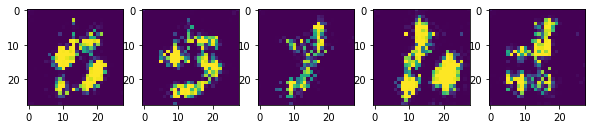

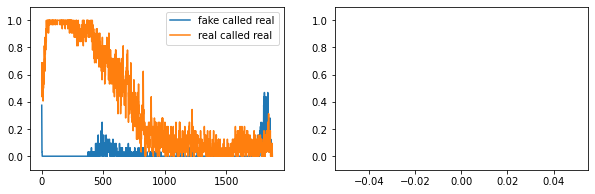

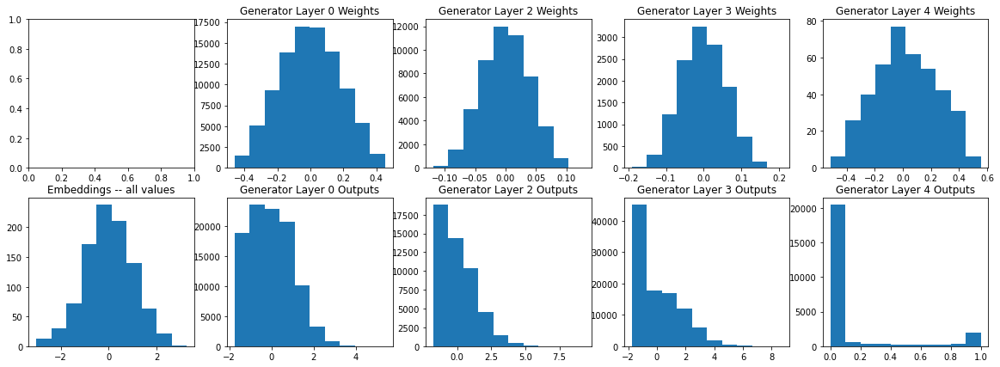

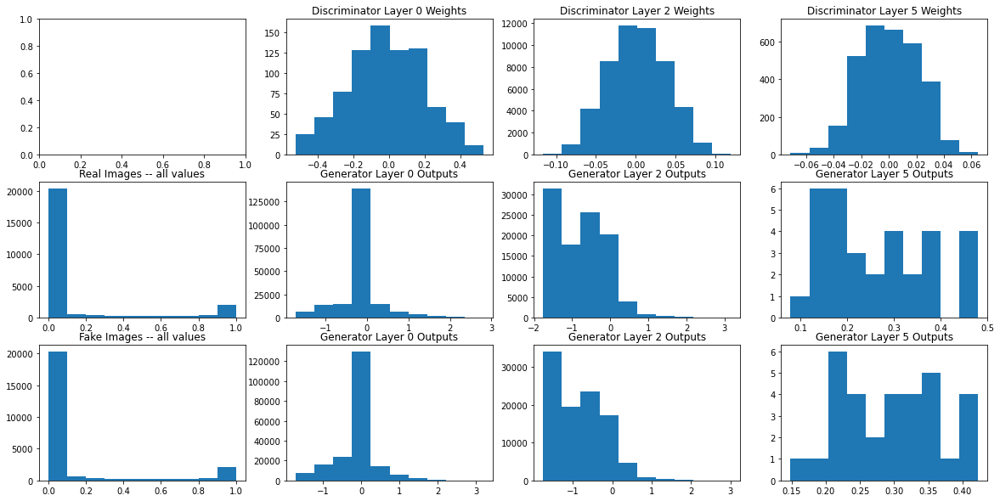

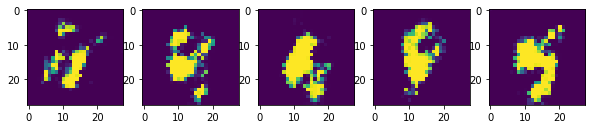

...

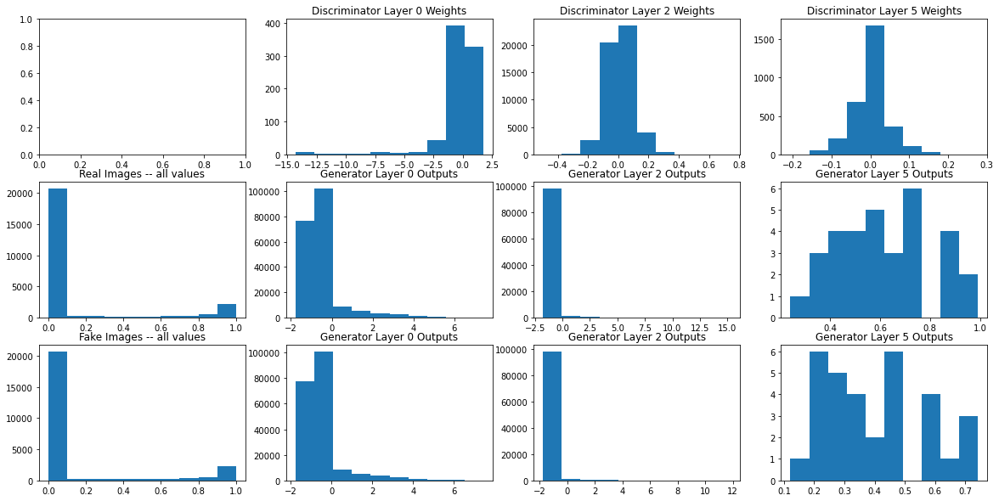

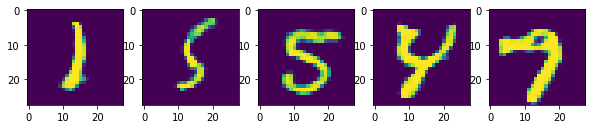

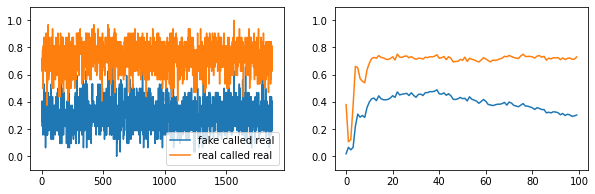

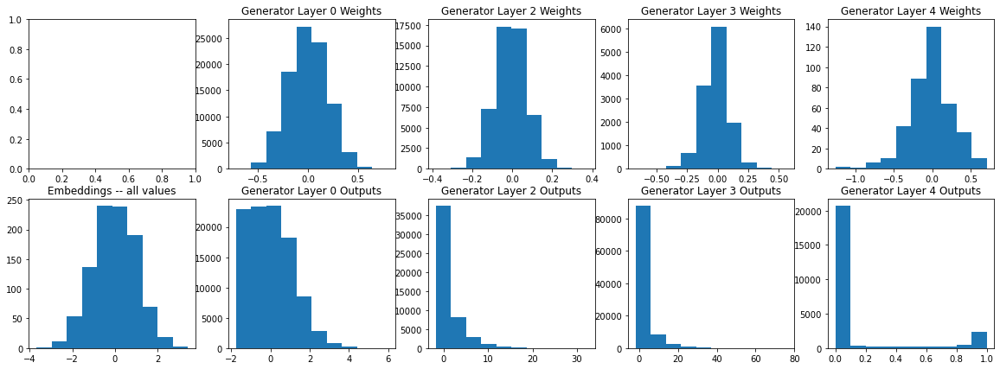

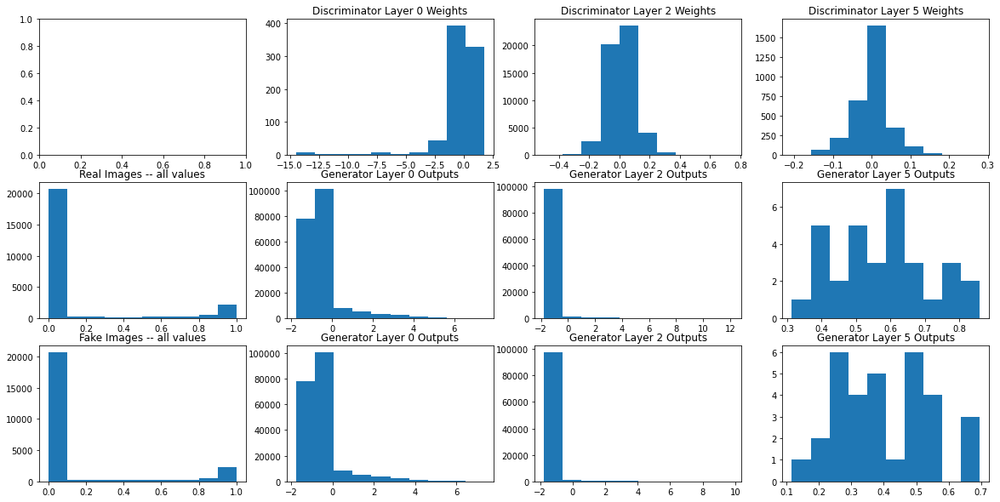

In [16]:
number_epochs = 100

true_acc_ave,fake_acc_ave = [],[]
for epoch in range(number_epochs):
    dis_loss,gan_loss = [],[]
    true_acc,fake_acc = [],[]
    
    for X,x in train_dataset:
        
        random_embedding = tf.random.normal([batch_size, embedding_dimension])
        tildeX = dc_generator(random_embedding)
        tildeY = [[0.]]*batch_size
        
        Y = [[1.]]*batch_size
        X_tildeX = tf.concat([X, tildeX], axis=0)
        Y_tildeY = tf.constant(Y+tildeY)
        Y = tf.constant(Y)
        dc_discriminator.trainable = True
        dc_discriminator.train_on_batch(X_tildeX, Y_tildeY)
        # we actually alternate, as opposed to: https://www.activestate.com/blog/how-to-build-a-generative-adversarial-network-gan/

        fake_acc += [(dc_discriminator(tildeX)>0.5).numpy().sum()/batch_size]
        true_acc += [(dc_discriminator(X)>0.5).numpy().sum()/batch_size]

        dc_discriminator.trainable = False
        # gan.metrics_names
        random_embedding = tf.random.normal([batch_size, embedding_dimension])
        gan_loss += [gan.train_on_batch(random_embedding, Y)]
        # we actually alternate, as opposed to: https://www.activestate.com/blog/how-to-build-a-generative-adversarial-network-gan/



    fig,ax = plt.subplots(1,5, figsize=(10,10))
    ax = ax.flatten()
    for i in range(5):
        ax[i].imshow(dc_generator(random_embedding).numpy() [i,...,0])
    plt.show()
    fig,ax = plt.subplots(1,2, figsize=(10,3))
    ax = ax.flatten()
    ax[0].plot(fake_acc, label='fake called real')
    ax[0].plot(true_acc, label='real called real')
    ax[0].set_ylim([-0.1,1.1])
    ax[0].legend()
    true_acc_ave += [np.mean(true_acc)]
    fake_acc_ave += [np.mean(fake_acc)]
    ax[1].plot(fake_acc_ave, label='fake called real')
    ax[1].plot(true_acc_ave, label='real called real')
    ax[1].set_ylim([-0.1,1.1])
    plt.show()
        
    fig,ax = plt.subplots(2,5, figsize=(20,7))
    ax = ax.flatten()    
    ax[1].hist(dc_generator.layers[0].weights[0].numpy().flatten())
    ax[1].set_title('Generator Layer '+str(0)+' Weights')    
    for i in range(3):
        ax[i+2].hist(dc_generator.layers[i+2].weights[0].numpy().flatten())
        ax[i+2].set_title('Generator Layer '+str(i+2)+' Weights')
    ax[5].hist(random_embedding.numpy().flatten())
    ax[5].set_title('Embeddings -- all values')
    dc_generator_layer_output = Model(dc_generator.input, dc_generator.layers[0].output)
    ax[6].hist(dc_generator_layer_output(random_embedding).numpy().flatten())
    ax[6].set_title('Generator Layer '+str(0)+' Outputs')
    for i in range(3):
        dc_generator_layer_output = Model(dc_generator.input, dc_generator.layers[i+2].output)
        ax[i+7].hist(dc_generator_layer_output(random_embedding).numpy().flatten())
        ax[i+7].set_title('Generator Layer '+str(i+2)+' Outputs')
    plt.show()


    fig,ax = plt.subplots(3,4, figsize=(20,10))
    ax = ax.flatten() 
    ax[1].hist(dc_discriminator.layers[0].weights[0].numpy().flatten())
    ax[1].set_title('Discriminator Layer '+str(0)+' Weights')    
    ax[2].hist(dc_discriminator.layers[2].weights[0].numpy().flatten())
    ax[2].set_title('Discriminator Layer '+str(2)+' Weights')    
    ax[3].hist(dc_discriminator.layers[-1].weights[0].numpy().flatten())
    ax[3].set_title('Discriminator Layer '+str(5)+' Weights')    
    ax[4].hist(tildeX.numpy().flatten())
    ax[4].set_title('Real Images -- all values')
    dc_discriminator_layer_output = Model(dc_discriminator.input, dc_discriminator.layers[0].output)
    ax[5].hist(dc_discriminator_layer_output(X).numpy().flatten())
    ax[5].set_title('Generator Layer '+str(0)+' Outputs')
    dc_discriminator_layer_output = Model(dc_discriminator.input, dc_discriminator.layers[2].output)
    ax[6].hist(dc_discriminator_layer_output(X).numpy().flatten())
    ax[6].set_title('Generator Layer '+str(2)+' Outputs')
    dc_discriminator_layer_output = Model(dc_discriminator.input, dc_discriminator.layers[5].output)
    ax[7].hist(dc_discriminator_layer_output(X).numpy().flatten())
    ax[7].set_title('Generator Layer '+str(5)+' Outputs')
    ax[8].hist(tildeX.numpy().flatten())
    ax[8].set_title('Fake Images -- all values')
    dc_discriminator_layer_output = Model(dc_discriminator.input, dc_discriminator.layers[0].output)
    ax[9].hist(dc_discriminator_layer_output(tildeX).numpy().flatten())
    ax[9].set_title('Generator Layer '+str(0)+' Outputs')
    dc_discriminator_layer_output = Model(dc_discriminator.input, dc_discriminator.layers[2].output)
    ax[10].hist(dc_discriminator_layer_output(tildeX).numpy().flatten())
    ax[10].set_title('Generator Layer '+str(2)+' Outputs')
    dc_discriminator_layer_output = Model(dc_discriminator.input, dc_discriminator.layers[5].output)
    ax[11].hist(dc_discriminator_layer_output(tildeX).numpy().flatten())
    ax[11].set_title('Generator Layer '+str(5)+' Outputs')
    plt.show()


# ^^^OSCILATION/CONVERGENCE LOOKS LIKE A POTENTIAL ISSUE^^^

# CGAN: Conditional GAN
- Uses labels to seed generator
- Uses label smoothing (regularization, to allow real "messy digits" to be "fake")
- scaling image to [-1,1] rather than [0,1]

In [18]:
# https://www.tensorflow.org/probability/examples/Probabilistic_Layers_VAE

datasets, datasets_info = tfds.load(name='mnist', with_info=True,
                                    as_supervised=True) # we're using Y label now to help generate image

def _preprocess(image, label):
    image = tf.cast(image, tf.float32) / 127.5 - 1.  # Scale to unit interval.
    #image = image < tf.random.uniform(tf.shape(image))   # Randomly binarize.
    return image, label#tf.cast(label, tf.float32)/5. - 1.

batch_size = 32
BUFFER_SIZE = 60000
train_dataset = (datasets['train']
                 .map(_preprocess)
                 .shuffle(BUFFER_SIZE)
                 .batch(batch_size, drop_remainder=True)
                 .prefetch(tf.data.experimental.AUTOTUNE))

eval_dataset = (datasets['test']
                .map(_preprocess)
                .batch(batch_size, drop_remainder=True)
                .prefetch(tf.data.experimental.AUTOTUNE))

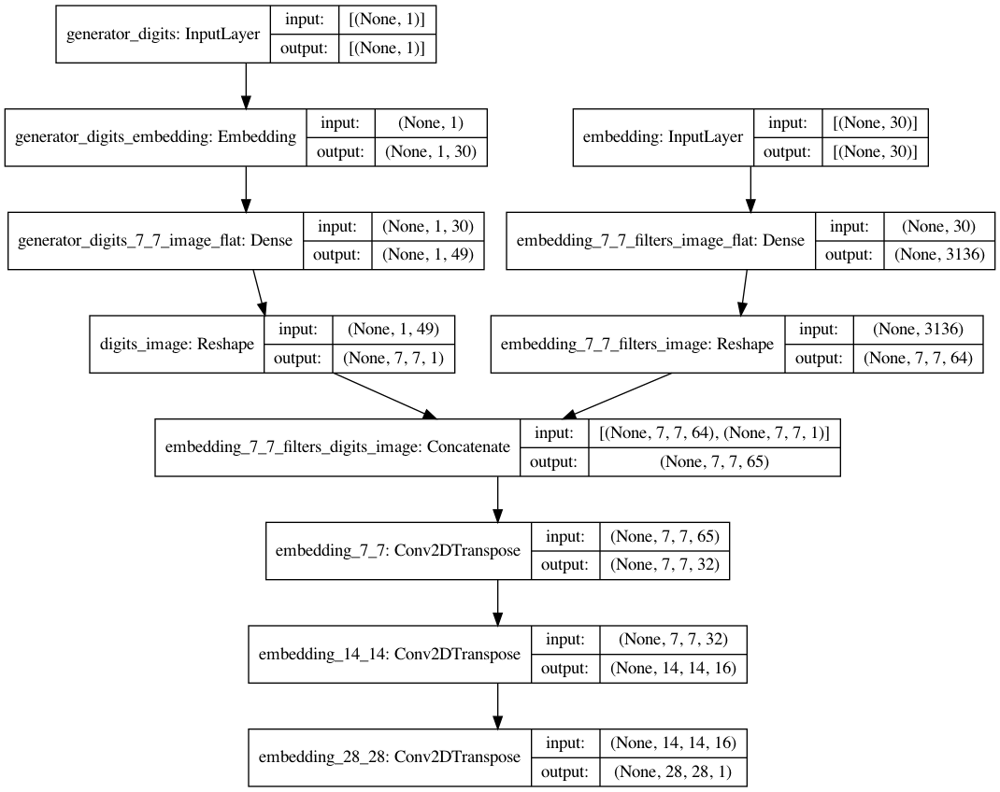

In [19]:
# https://www.tensorflow.org/tutorials/generative/dcgan
# https://machinelearningmastery.com/visualize-deep-learning-neural-network-model-keras/

from tensorflow.keras.layers import Input, Embedding, Concatenate
from tensorflow.keras.utils import plot_model


generator_digits = \
    Input(shape=(1,),
          name='generator_digits')

generator_digits_embedding = \
    Embedding(10, embedding_dimension,
              name='generator_digits_embedding')(generator_digits)
    
generator_digits_7_7_image_flat = \
    Dense(7*7, use_bias=True, 
          activation='selu', kernel_initializer='lecun_normal',
          name='generator_digits_7_7_image_flat')(generator_digits_embedding)

generator_digits_7_7_1_image = \
    Reshape([7,7,1],
            name='digits_image')(generator_digits_7_7_image_flat)


embedding = \
    Input(shape=(embedding_dimension,),
          name='embedding')

embedding_7_7_filters_image_flat = \
    Dense(7*7*64, use_bias=True, 
          activation='selu', kernel_initializer='lecun_normal',
          name='embedding_7_7_filters_image_flat')(embedding)

embedding_7_7_filters_image = \
    Reshape((7, 7, 64),
           name='embedding_7_7_filters_image')(embedding_7_7_filters_image_flat)

embedding_7_7_filters_digits_image = \
    Concatenate(name='embedding_7_7_filters_digits_image')([embedding_7_7_filters_image, generator_digits_7_7_1_image])
                  
embedding_7_7 = \
    Conv2DTranspose(32, 5, strides=1, padding='same', use_bias=True, 
                    activation='selu', kernel_initializer='lecun_normal',
                    name='embedding_7_7')(embedding_7_7_filters_digits_image)
embedding_14_14 = \
    Conv2DTranspose(16, 5, strides=2, padding='same', use_bias=True, 
                    activation='selu', kernel_initializer='lecun_normal',
                    name='embedding_14_14')(embedding_7_7)

embedding_28_28 = \
    Conv2DTranspose(1, 5, strides=2, padding='same', use_bias=True, 
                    activation='tanh', kernel_initializer='lecun_normal',
                    name='embedding_28_28')(embedding_14_14)

c_generator = Model([embedding, generator_digits], embedding_28_28)
plot_model(c_generator, to_file='model_plot.png', show_shapes=True, show_layer_names=True)



In [20]:
# adding the labels as inputs
# so we'll generate outputs: CONDITIONAL ON THE LABELS -- which simpifies our task of making better images

for X,Y in train_dataset:
    Y
Y

<tf.Tensor: shape=(32,), dtype=int64, numpy=
array([8, 3, 0, 2, 7, 8, 7, 9, 9, 6, 4, 0, 7, 5, 5, 5, 3, 1, 0, 7, 2, 2,
       3, 7, 0, 7, 7, 3, 2, 1, 0, 1])>

In [21]:
# -1 to 1 image pixel range
X.numpy().min(),X.numpy().max()

(-1.0, 1.0)

In [22]:
# tanh output goes to same range

random_embedding = tf.random.normal([batch_size, embedding_dimension])

c_generator([random_embedding,Y]).numpy().flatten().min(),c_generator([random_embedding,Y]).numpy().flatten().max()
        

(-1.0, 1.0)

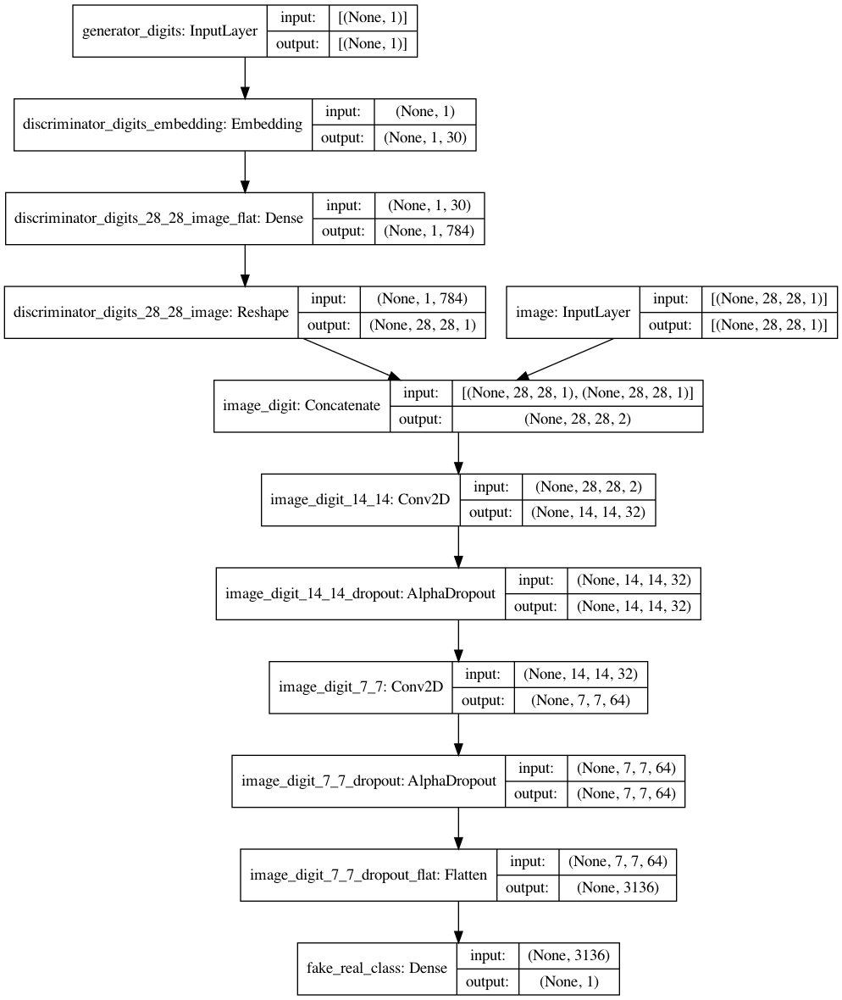

In [23]:
discriminator_digits = \
    Input(shape=(1,),
          name='generator_digits')

discriminator_digits_embedding = \
    Embedding(10, embedding_dimension,
              name='discriminator_digits_embedding')(discriminator_digits)
    
discriminator_digits_28_28_image_flat = \
    Dense(28*28, use_bias=True, 
          activation='selu', kernel_initializer='lecun_normal',
          name='discriminator_digits_28_28_image_flat')(discriminator_digits_embedding)

discriminator_digits_28_28_image = \
    Reshape([28,28,1],
            name='discriminator_digits_28_28_image')(discriminator_digits_28_28_image_flat)

image = \
    Input(shape=[28,28,1],
          name='image')

image_digit = \
    Concatenate(name='image_digit')([image, discriminator_digits_28_28_image])
    
image_digit_14_14 = \
    Conv2D(32, 5, strides=2, padding='same', use_bias=True, 
           activation='selu', kernel_initializer='lecun_normal',
           name='image_digit_14_14')(image_digit)
    
image_digit_14_14_dropout = \
    AlphaDropout(0.25,
                 name='image_digit_14_14_dropout')(image_digit_14_14)

image_digit_7_7 = \
    Conv2D(64, 5, strides=2, padding='same', use_bias=True, 
           activation='selu', kernel_initializer='lecun_normal',
           name='image_digit_7_7')(image_digit_14_14_dropout)

image_digit_7_7_dropout = \
    AlphaDropout(0.25,
                 name='image_digit_7_7_dropout')(image_digit_7_7)

image_digit_7_7_dropout_flat = \
    Flatten(name='image_digit_7_7_dropout_flat')(image_digit_7_7_dropout)
    
fake_real_class = \
    Dense(1, activation='sigmoid',
          name='fake_real_class')(image_digit_7_7_dropout_flat)

c_discriminator = Model([image, discriminator_digits], fake_real_class)
plot_model(c_discriminator, to_file='model_plot.png', show_shapes=True, show_layer_names=True)




- [above] Just as the `generator` gets to use the label, so do does the `discriminator`
- [below] Allowing label smoothing on BOTH `discriminator` AND `generator`
    - allows "messy" digits to count against us/mess us up less in the `discriminator`
    - while also softening the learning signal for the `generator`

In [24]:
cross_entropy_1 = tf.keras.losses.BinaryCrossentropy(label_smoothing=0.1)
cross_entropy_0 = tf.keras.losses.BinaryCrossentropy()


def discriminator_loss(real_output, fake_output):

    '''real_output: probability prediction for real images (should be 1 for discriminator)
       fake_output: probability prediction for fake images (should be 0 for discriminator)'''
    
    # DISCRIMINATOR LEARNS FROM TRUE LABELS (REAL:1, FAKE:0)
    real_loss = cross_entropy_1(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy_0(tf.zeros_like(fake_output), fake_output)
    total_loss = real_loss + fake_loss
    return total_loss


def generator_loss(fake_output):

    '''fake_output: probability prediction for fake images (should be 1 for generator)'''
    
    # GENERATOR WANTS PREDICTIONS CREATED IMAGES TO BE 1
    return cross_entropy_1(tf.ones_like(fake_output), fake_output)


discriminator_optimizer = tf.keras.optimizers.Adam(1e-3)
generator_optimizer = tf.keras.optimizers.Adam(1e-3)


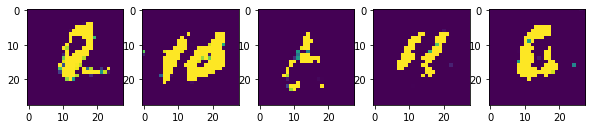

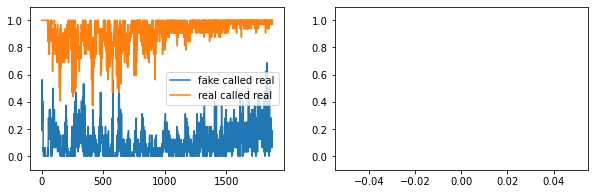

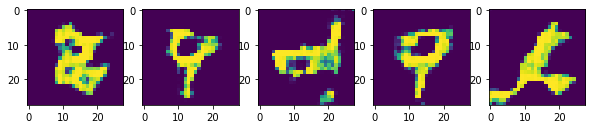

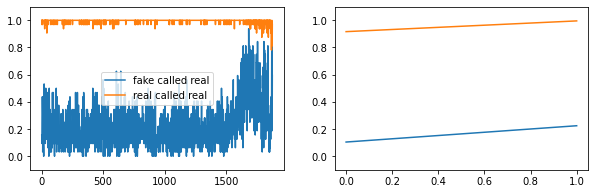

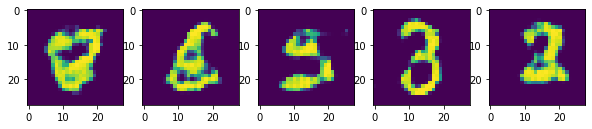

...

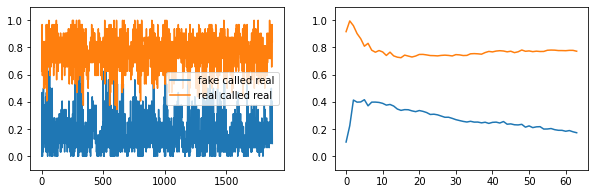

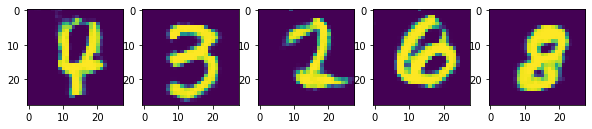

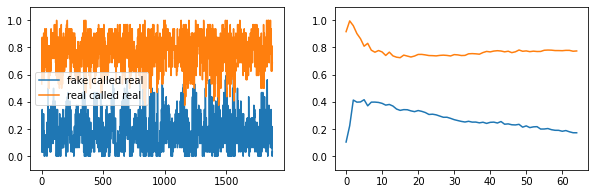

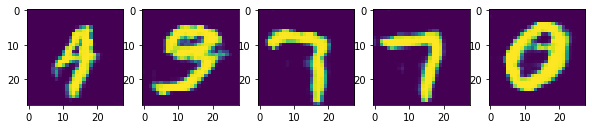

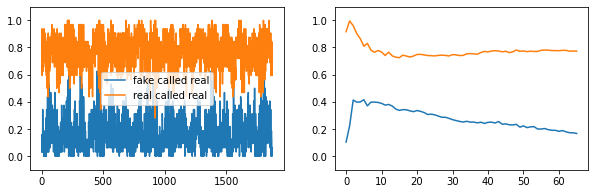

KeyboardInterrupt: 

In [25]:
number_epochs = 100

# EPOCS LOOP
true_acc_ave,fake_acc_ave = [],[]
for epoch in range(number_epochs):

    # BATCHES LOOP
    dis_loss,gan_loss = [],[]
    true_acc,fake_acc = [],[]
    for X,digit in train_dataset:
        
        # SEED GENERATOR
        random_embedding = tf.random.normal([batch_size, embedding_dimension])
        
        # SIMULTANEOUS UPDATE
        with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
            
            # RUN GENERATOR
            tildeX = c_generator([random_embedding,digit])
            
            # GET DISCRIMINATOR PROBABILITY PREDICTIONS
            real_output = c_discriminator([X,digit], training=True)
            fake_output = c_discriminator([tildeX,digit], training=True)

            # GET LOSSES
            gen_loss = generator_loss(fake_output)
            disc_loss = discriminator_loss(real_output, fake_output)

        # PARTITION PARAMETERS WITH CORRESPONDING LOSSES
        # IN ORDER CALCULATE GRADIENTS SIMULTANEOUS
        # - c_generator.trainable_variables
        # - gen_loss
        gradients_of_generator = gen_tape.gradient(gen_loss, c_generator.trainable_variables)
        # - c_discriminator.trainable_variables
        # - disc_loss
        gradients_of_discriminator = disc_tape.gradient(disc_loss, c_discriminator.trainable_variables)

        # APPLY GRADIENTS SIMULTANEOUS
        generator_optimizer.apply_gradients(zip(gradients_of_generator, c_generator.trainable_variables))
        discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, c_discriminator.trainable_variables))
    
        # performance tracking
        fake_acc += [(c_discriminator([tildeX,digit])>0.5).numpy().sum()/batch_size]
        true_acc += [(c_discriminator([X,digit])>0.5).numpy().sum()/batch_size]

    fig,ax = plt.subplots(1,5, figsize=(10,10))
    ax = ax.flatten()
    for i in range(5):
        ax[i].imshow(tildeX.numpy() [i,...,0])
    plt.show()
    fig,ax = plt.subplots(1,2, figsize=(10,3))
    ax = ax.flatten()
    ax[0].plot(fake_acc, label='fake called real')
    ax[0].plot(true_acc, label='real called real')
    ax[0].set_ylim([-0.1,1.1])
    ax[0].legend()
    true_acc_ave += [np.mean(true_acc)]
    fake_acc_ave += [np.mean(fake_acc)]
    ax[1].plot(fake_acc_ave, label='fake called real')
    ax[1].plot(true_acc_ave, label='real called real')
    ax[1].set_ylim([-0.1,1.1])
    plt.show()
        

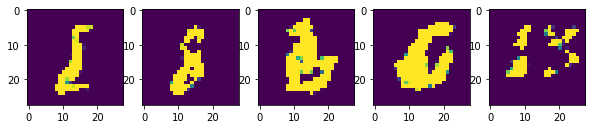

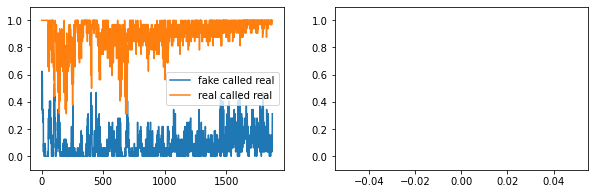

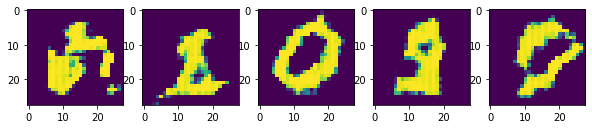

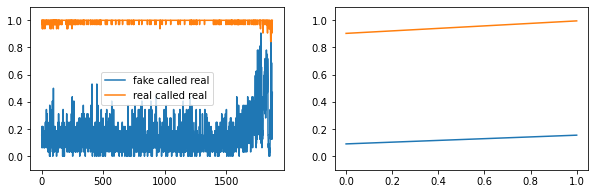

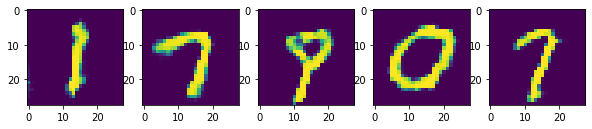

...

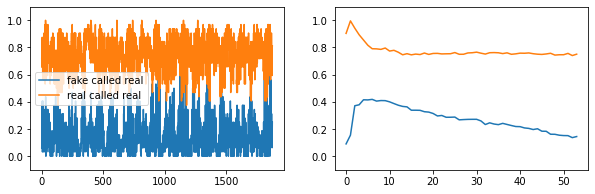

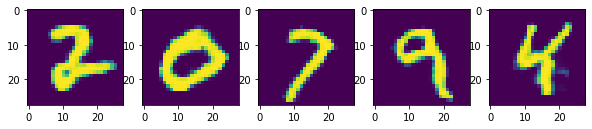

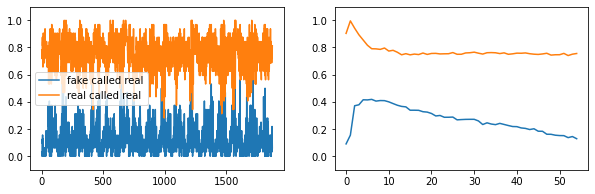

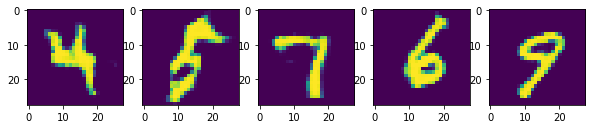

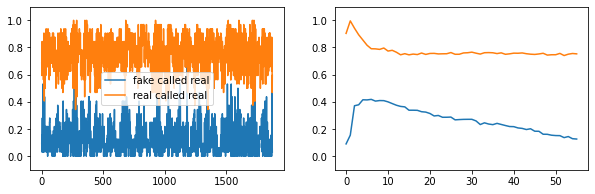

KeyboardInterrupt: 

In [495]:
number_epochs = 100

true_acc_ave,fake_acc_ave = [],[]
for epoch in range(number_epochs):
    dis_loss,gan_loss = [],[]
    true_acc,fake_acc = [],[]
    
    for X,digit in train_dataset:
        
        random_embedding = tf.random.normal([batch_size, embedding_dimension])
        
        with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
            tildeX = c_generator([random_embedding,digit])
            real_output = c_discriminator([X,digit], training=True)
            fake_output = c_discriminator([tildeX,digit], training=True)

            gen_loss = generator_loss(fake_output)
            disc_loss = discriminator_loss(real_output, fake_output)

        gradients_of_generator = gen_tape.gradient(gen_loss, c_generator.trainable_variables)
        gradients_of_discriminator = disc_tape.gradient(disc_loss, c_discriminator.trainable_variables)

        generator_optimizer.apply_gradients(zip(gradients_of_generator, c_generator.trainable_variables))
        discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, c_discriminator.trainable_variables))
    

        fake_acc += [(c_discriminator([tildeX,digit])>0.5).numpy().sum()/batch_size]
        true_acc += [(c_discriminator([X,digit])>0.5).numpy().sum()/batch_size]

    fig,ax = plt.subplots(1,5, figsize=(10,10))
    ax = ax.flatten()
    for i in range(5):
        ax[i].imshow(tildeX.numpy() [i,...,0])
    plt.show()
    fig,ax = plt.subplots(1,2, figsize=(10,3))
    ax = ax.flatten()
    ax[0].plot(fake_acc, label='fake called real')
    ax[0].plot(true_acc, label='real called real')
    ax[0].set_ylim([-0.1,1.1])
    ax[0].legend()
    true_acc_ave += [np.mean(true_acc)]
    fake_acc_ave += [np.mean(fake_acc)]
    ax[1].plot(fake_acc_ave, label='fake called real')
    ax[1].plot(true_acc_ave, label='real called real')
    ax[1].set_ylim([-0.1,1.1])
    plt.show()
        

### Some other things to check out if this stuff is your jam

- CycleGANs (for domain transformation)
    - `https://www.tensorflow.org/tutorials/generative/cyclegan`
    - D competes Zebra(H) and Z 
    - subject to Horse(Zebra(H)) looknig like H
- PG-GANs (progressively growing GANs)
- StyleGANs (style-based generators) 
    

# Getting Models into Production!


- Daily model calls
    - Expose model in web service with an API [application programmers interface], e.g.,
        - REST [REpresentational State Transfer protocol]
        - gRPC [(google) Remote Procedure Call protocol]
    - Support high queries per second (QPS) load
    - Fast turn-around for compute-intensive models (by using more powerful computing instances)
- Daily model refreshes on builds, i.e., new model uploads
    - Model versioning
    - Smooth model transitioning
        - Model rollback
        - Multiple models management (A/B tests?)
            - Rapid model development/experimentation

## Model Deployment Pathways

1. [Today]: TF Serving
    - "Out of the box" API supporting different distribution strategies 
2. [(next) Monday]: Google Cloud AI Platform
    - Web apps
3. [(next) Wednesday]: Mobile apps
    - Embedded devices


# `tf.saved_model`
- **You should include data preprocessing directly into the model so that's not a separate task**
    - *below we'll see this cause a problem for us*
- You can save models with extension `.h5` for `HDF5` format; otherwise, it's `SavedModel` format
    - This creates a (TF) computational graph, so any python code wrapping (with `tf.py_function()`) will break!
        - You'd have to serve live python code, e.g., with Flask if you wanted that...
- model.save(model_path), or:


In [155]:
! rm -r ../MNISTS_digits_discriminator/*
! ls ../MNISTS_digits_discriminator


In [156]:
discriminator

In [157]:
# NOTE THAT MODEL VERSIONS *MUST BE* NUMBERS

import os

model_name = "MNISTS_digits_generator"

model_version = "0001"
model_path = os.path.join('../',model_name, model_version)
tf.saved_model.save(generator, model_path)
model_version = "0002"
model_path = os.path.join('../',model_name, model_version)
tf.saved_model.save(dc_generator, model_path)
model_version = "0003"
model_path = os.path.join('../',model_name, model_version)
tf.saved_model.save(c_generator, model_path)


model_name = "MNISTS_digits_discriminator"

model_version = "0001"
model_path = os.path.join('../',model_name, model_version)
tf.saved_model.save(discriminator, model_path)
model_version = "0002"
model_path = os.path.join('../',model_name, model_version)
tf.saved_model.save(dc_discriminator, model_path)
model_version = "0003"
model_path = os.path.join('../',model_name, model_version)
tf.saved_model.save(c_discriminator, model_path)


INFO:tensorflow:Assets written to: ../MNISTS_digits_generator/0001/assets


INFO:tensorflow:Assets written to: ../MNISTS_digits_generator/0001/assets


INFO:tensorflow:Assets written to: ../MNISTS_digits_generator/0002/assets


INFO:tensorflow:Assets written to: ../MNISTS_digits_generator/0002/assets


INFO:tensorflow:Assets written to: ../MNISTS_digits_generator/0003/assets


INFO:tensorflow:Assets written to: ../MNISTS_digits_generator/0003/assets


INFO:tensorflow:Assets written to: ../MNISTS_digits_discriminator/0001/assets


INFO:tensorflow:Assets written to: ../MNISTS_digits_discriminator/0001/assets


INFO:tensorflow:Assets written to: ../MNISTS_digits_discriminator/0002/assets


INFO:tensorflow:Assets written to: ../MNISTS_digits_discriminator/0002/assets


INFO:tensorflow:Assets written to: ../MNISTS_digits_discriminator/0003/assets


INFO:tensorflow:Assets written to: ../MNISTS_digits_discriminator/0003/assets


In [158]:
# brew install tree
! tree ../MNISTS_digits_discriminator/


../MNISTS_digits_discriminator/
├── 0001
│   ├── assets
│   ├── saved_model.pb
│   └── variables
│       ├── variables.data-00000-of-00001
│       └── variables.index
├── 0002
│   ├── assets
│   ├── saved_model.pb
│   └── variables
│       ├── variables.data-00000-of-00001
│       └── variables.index
└── 0003
    ├── assets
    ├── saved_model.pb
    └── variables
        ├── variables.data-00000-of-00001
        └── variables.index

9 directories, 9 files


In [159]:
for X,digit in train_dataset:
    pass

digit

<tf.Tensor: shape=(32,), dtype=int64, numpy=
array([1, 9, 1, 1, 4, 9, 2, 6, 6, 9, 4, 0, 2, 9, 4, 8, 2, 2, 2, 0, 2, 3,
       4, 4, 7, 2, 0, 6, 1, 7, 0, 3])>

In [160]:
X.shape

TensorShape([32, 28, 28, 1])

(array([20574.,   297.,   304.,   220.,   245.,   284.,   230.,   296.,
          346.,  2292.]),
 array([-1. , -0.8, -0.6, -0.4, -0.2,  0. ,  0.2,  0.4,  0.6,  0.8,  1. ],
       dtype=float32),
 <BarContainer object of 10 artists>)

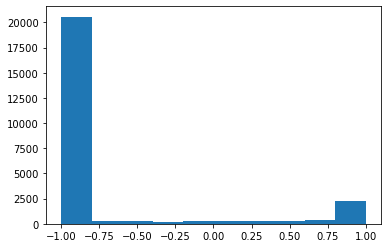

In [161]:
plt.hist(X.numpy().flatten())

- **You should include data preprocessing directly into the model so that's not a separate task**
    - *I.e., what we have below is a problem because we have to "remember" what the right preprocessing is*

In [172]:
discriminator(X)
# ABOVE IS WRONG... WE SHOULD ACTUALLY BE CALLING IT LIKE BELOW
discriminator((X+1)/2)

#dc_discriminator(X)
# ABOVE IS WRONG... WE SHOULD ACTUALLY BE CALLING IT LIKE BELOW
#dc_discriminator((X+1)/2)

# THIS IS CORRECT FOR THIS MODEL
c_discriminator([X, digit])

<tf.Tensor: shape=(32, 1), dtype=float32, numpy=
array([[0.5583932 ],
       [0.86236024],
       [0.95985603],
       [0.46582443],
       [0.9824823 ],
       [0.7050674 ],
       [0.7794875 ],
       [0.42148623],
       [0.8038522 ],
       [0.8661291 ],
       [0.44443747],
       [0.5544786 ],
       [0.6634787 ],
       [0.8173554 ],
       [0.88560414],
       [0.9757192 ],
       [0.6321588 ],
       [0.9500418 ],
       [0.998857  ],
       [0.12038061],
       [0.84363204],
       [0.99219465],
       [0.97846615],
       [0.9996337 ],
       [0.69972205],
       [0.9653946 ],
       [0.29929453],
       [0.8339056 ],
       [0.40365407],
       [0.83967876],
       [0.91524017],
       [0.47602084]], dtype=float32)>

In [171]:
# INPUTS TYPES

digit

<tf.Tensor: shape=(32,), dtype=int64, numpy=
array([1, 9, 1, 1, 4, 9, 2, 6, 6, 9, 4, 0, 2, 9, 4, 8, 2, 2, 2, 0, 2, 3,
       4, 4, 7, 2, 0, 6, 1, 7, 0, 3])>

In [186]:
# INPUT SHAPES

#discriminator.input
#dc_discriminator.input
c_discriminator.input

[<KerasTensor: shape=(None, 28, 28, 1) dtype=float32 (created by layer 'image')>,
 <KerasTensor: shape=(None, 1) dtype=float32 (created by layer 'generator_digits')>]

- ABOVE are our fitted models, not the saved versions
- BELOW is what happens when we ***re-load*** our saved versions
    - There are two new problems we can encounter because saved models are slightly different than live models
        1. expected data TYPE
        2. expected data DIMS
        
*and don't forget we still potentially have the* ***differently preprocessed(?) issue***

In [191]:
saved_and_loaded_GAN_discriminator = \
    tf.saved_model.load("../MNISTS_digits_discriminator/0003")
# possible problems:
# 0. normalized/preprocessed differently
# 1. expected input type differ
# 2. expected input dims differ

# WHICH CALL SPECIFICATION IS CORRECT FOR EACH MODEL?
#saved_and_loaded_GAN_discriminator(X)
#saved_and_loaded_GAN_discriminator(X[...,0])
#saved_and_loaded_GAN_discriminator((X[...,0]+1)/2)
#saved_and_loaded_GAN_discriminator((X+1)/2)
#saved_and_loaded_GAN_discriminator([X, digit])
#saved_and_loaded_GAN_discriminator([X, digit[:,np.newaxis]])
saved_and_loaded_GAN_discriminator([X,tf.cast(digit,'float32')[:,np.newaxis]])

<tf.Tensor: shape=(32, 1), dtype=float32, numpy=
array([[0.5583925 ],
       [0.8623598 ],
       [0.9598559 ],
       [0.46582407],
       [0.9824824 ],
       [0.7050672 ],
       [0.779487  ],
       [0.42148626],
       [0.80385154],
       [0.8661289 ],
       [0.44443652],
       [0.55447817],
       [0.663479  ],
       [0.81735516],
       [0.88560426],
       [0.9757192 ],
       [0.632158  ],
       [0.95004165],
       [0.99885714],
       [0.1203801 ],
       [0.84363234],
       [0.99219465],
       [0.9784661 ],
       [0.9996337 ],
       [0.6997217 ],
       [0.9653946 ],
       [0.29929385],
       [0.8339052 ],
       [0.40365317],
       [0.8396788 ],
       [0.9152398 ],
       [0.47602025]], dtype=float32)>

In [189]:
digit[:,np.newaxis].shape

TensorShape([32, 1])

In [192]:
#discriminator((X+1)/2)
#dc_discriminator((X+1)/2)
c_discriminator([X, digit])

<tf.Tensor: shape=(32, 1), dtype=float32, numpy=
array([[0.5583932 ],
       [0.86236024],
       [0.95985603],
       [0.46582443],
       [0.9824823 ],
       [0.7050674 ],
       [0.7794875 ],
       [0.42148623],
       [0.8038522 ],
       [0.8661291 ],
       [0.44443747],
       [0.5544786 ],
       [0.6634787 ],
       [0.8173554 ],
       [0.88560414],
       [0.9757192 ],
       [0.6321588 ],
       [0.9500418 ],
       [0.998857  ],
       [0.12038061],
       [0.84363204],
       [0.99219465],
       [0.97846615],
       [0.9996337 ],
       [0.69972205],
       [0.9653946 ],
       [0.29929453],
       [0.8339056 ],
       [0.40365407],
       [0.83967876],
       [0.91524017],
       [0.47602084]], dtype=float32)>

# TensorFlow/Serving

## Versioning

- TF server requires "0001" style
- Automatically uses the latest version
- Automatically updates and reverts to new and old (most recent) version

In [194]:
#! rm -r /Users/gck8gd/Documents/courses/SYS_6016_DeepLearning/MNISTS_digits_discriminator/0003
! ls /Users/gck8gd/Documents/courses/SYS_6016_DeepLearning/MNISTS_digits_discriminator

0001 0002 0003


- ABOVE we can remove versions *[and the version used by TF/Serving being used will automatically update]*
- BELOW we add versions back in *[and the version used by TF/Serving being used will automatically update]*

In [203]:
model_name = "MNISTS_digits_discriminator"

model_version = "0001"
model_path = os.path.join('../',model_name, model_version)
tf.saved_model.save(discriminator, model_path)
model_version = "0002"
model_path = os.path.join('../',model_name, model_version)
tf.saved_model.save(dc_discriminator, model_path)
model_version = "0003"
model_path = os.path.join('../',model_name, model_version)
tf.saved_model.save(c_discriminator, model_path)


INFO:tensorflow:Assets written to: ../MNISTS_digits_discriminator/0001/assets


INFO:tensorflow:Assets written to: ../MNISTS_digits_discriminator/0001/assets


INFO:tensorflow:Assets written to: ../MNISTS_digits_discriminator/0002/assets


INFO:tensorflow:Assets written to: ../MNISTS_digits_discriminator/0002/assets


INFO:tensorflow:Assets written to: ../MNISTS_digits_discriminator/0003/assets


INFO:tensorflow:Assets written to: ../MNISTS_digits_discriminator/0003/assets


## Docker

We can set up and use tensorflow/serving with/from a docker image

- https://www.docker.com/get-started
- Download and Install "Docker Desktop" (super easy)
- "Double Click" Docker application to start it
    - you'll see the little "whale" program running in the upper right on the menu bar
    
- then grab the pre-made, "ready to use out of the box" tensorflow/serving image:

In [195]:
! docker pull tensorflow/serving

Using default tag: latest
latest: Pulling from tensorflow/serving
Digest: sha256:d984dbe2de34e131dbdd7f85ba993696da56c89b91f0b2559e482598919a2c5e
Status: Image is up to date for tensorflow/serving:latest
docker.io/tensorflow/serving:latest


- and start a container from the image:

In [734]:
# fire up container from `tensorflow/serving` image
# -p: talk to container through API-ready ports
#     gRPC (8500) [google remote proceedure call] and REST (8501) [representational state transfer]
#     localhost:container
# -v: map a directory into the container directory structure
# -e: give container environment variable `MODEL_NAME`
# -it: run here interactively
# -rm: remove container upon shutdown
! docker run -p 8500:8500 -p 8501:8501 \
             -v "/Users/gck8gd/Documents/courses/SYS_6016_DeepLearning/MNISTS_digits_discriminator:/models/MNISTS_GAN_discriminator" \
             -e MODEL_NAME="MNISTS_GAN_discriminator" \
             -it --rm \
             tensorflow/serving

# we'll go run this in the command line        

docker: Error response from daemon: driver failed programming external connectivity on endpoint friendly_chaum (9173c5edc094fba1a4369a2326668ceea79904de8f770d8b9ddf15092eb1687b): Bind for 0.0.0.0:8501 failed: port is already allocated.


## REST API
*REpresentational State Transfer* protocol *Application Programmer Interface*
- **is a fully verbose string based serialization protocol**
- Full details on the communication formating are available here: https://www.tensorflow.org/tfx/serving/api_rest
    - You can also use the `bash` `saved_model_cli` command (available once you've installed TF) to check requirements


**The tensorflow/serving resource is, compared to the previous ways to call models, is both**
- *less tricky: the last dimension can be included even if not requested (maybe that's more tricky?)*
- *more tricky: list of observations is required; but, and observation is a dictionary for multiple inputs*

In [196]:
X.shape

TensorShape([32, 28, 28, 1])

- So this works for both `0001` and `0002` model for tensorflow/serving...
    - *(remember that it didn't work when we tried to use it with a loaded saved model)*

In [202]:
import json

# signature_name if we had saved and wanted to call different model methods
input_data_json = json.dumps({
    "signature_name": "serving_default", 
    "instances": ((X.numpy()+1)/2).tolist(), # <- needs to match model input requirements
})


In [199]:
input_data_json

'{"signature_name": "serving_default", "instances": [[[[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0]], [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0]], [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0]], [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0]], [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.6549019813537598], [0.9764705896377563

- AND VERY IMPORTANTLY: ***IT NEEDS TO BE A LIST OF OBSERVATIONS***

### API Call!
- Our computer's `8501` REST port directly passes to the running docker containers's `8501` REST port

In [200]:
import requests

# REST (8501)                               # MODEL_NAME from docker command
SERVER_URL = 'http://localhost:8501/v1/models/MNISTS_GAN_discriminator:predict'
response = requests.post(SERVER_URL, data=input_data_json)
response.raise_for_status() # raise an exception in case of error
                            # e.g., if container is not running
                            # and hence server is not "on"
response = response.json()
response

{'predictions': [[0.393160045],
  [0.369371772],
  [0.519365907],
  [0.400348395],
  [0.525533617],
  [0.574309826],
  [0.795783043],
  [0.355021447],
  [0.912550092],
  [0.651747763],
  [0.672505617],
  [0.704458117],
  [0.833999038],
  [0.573897243],
  [0.797632039],
  [0.633449554],
  [0.819885552],
  [0.710616],
  [0.910879731],
  [0.729590297],
  [0.819899678],
  [0.948506594],
  [0.38459897],
  [0.686673641],
  [0.544043362],
  [0.784609318],
  [0.462086707],
  [0.867677629],
  [0.411259443],
  [0.500930905],
  [0.792875588],
  [0.757487535]]}

In [201]:
dc_discriminator((X+1)/2)
#discriminator((X+1)/2)

<tf.Tensor: shape=(32, 1), dtype=float32, numpy=
array([[0.39316204],
       [0.36937398],
       [0.51936495],
       [0.4003498 ],
       [0.5255346 ],
       [0.57430923],
       [0.7957835 ],
       [0.35502204],
       [0.91255015],
       [0.65174717],
       [0.67250645],
       [0.7044594 ],
       [0.83399856],
       [0.5738995 ],
       [0.7976321 ],
       [0.6334517 ],
       [0.8198868 ],
       [0.7106177 ],
       [0.91087985],
       [0.72959036],
       [0.81989956],
       [0.9485072 ],
       [0.38459772],
       [0.68667626],
       [0.5440464 ],
       [0.78460914],
       [0.46208927],
       [0.8676781 ],
       [0.41125843],
       [0.50093365],
       [0.79287505],
       [0.7574879 ]], dtype=float32)>

- but for the `0003` model (**WITH MULTIPLE INPUTS**) each observation must be a dictionary
    - **SO WE NEED A LIST OF DICTIONARIES FOR `0003`**
    - Full details on the communication formating are available here: https://www.tensorflow.org/tfx/serving/api_rest

In [207]:
# signature_name if we had saved and wanted to call different model methods
input_data_json = json.dumps({
    "signature_name": "serving_default", 
    "instances": [{'image': X.numpy()[i,...].tolist(), 
                   'generator_digits': tf.cast(digit,'float32')[i,np.newaxis].numpy().tolist()} 
                  for i in range(10)]
})


In [208]:
input_data_json

'{"signature_name": "serving_default", "instances": [{"image": [[[-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0]], [[-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0]], [[-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0]], [[-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0], [-1.0]], [[-1.0], [-1.0], [-1.0], [-1.0],

**And you MUST know the names, types, and shapes of your inputs for those dictionaries**
- you can get all of this for your `inputs` like this:

In [206]:
#https://laptrinhx.com/how-to-show-signatures-of-tensorflow-saved-model-4266662413/

! saved_model_cli show --dir ../MNISTS_digits_discriminator/0003 --all | head -30



MetaGraphDef with tag-set: 'serve' contains the following SignatureDefs:

signature_def['__saved_model_init_op']:
  The given SavedModel SignatureDef contains the following input(s):
  The given SavedModel SignatureDef contains the following output(s):
    outputs['__saved_model_init_op'] tensor_info:
        dtype: DT_INVALID
        shape: unknown_rank
        name: NoOp
  Method name is: 

signature_def['serving_default']:
  The given SavedModel SignatureDef contains the following input(s):
    inputs['generator_digits'] tensor_info:
        dtype: DT_FLOAT
        shape: (-1, 1)
        name: serving_default_generator_digits:0
    inputs['image'] tensor_info:
        dtype: DT_FLOAT
        shape: (-1, 28, 28, 1)
        name: serving_default_image:0
  The given SavedModel SignatureDef contains the following output(s):
    outputs['fake_real_class'] tensor_info:
        dtype: DT_FLOAT
        shape: (-1, 1)
        name: StatefulPartitionedCall:0
  Method name is: tensorflow/serv

- or like this (if the models are available and you can):

In [204]:
c_discriminator.inputs

[<KerasTensor: shape=(None, 28, 28, 1) dtype=float32 (created by layer 'image')>,
 <KerasTensor: shape=(None, 1) dtype=float32 (created by layer 'generator_digits')>]

In [205]:
c_discriminator.input_names

['image', 'generator_digits']

In [209]:
# REST (8501)                               # MODEL_NAME from docker command
SERVER_URL = 'http://localhost:8501/v1/models/MNISTS_GAN_discriminator:predict'
response = requests.post(SERVER_URL, data=input_data_json)
response.raise_for_status() # raise an exception in case of error
                            # e.g., if container is not running
                            # and hence server is not "on"
response = response.json()
response

{'predictions': [[0.558392525],
  [0.862359822],
  [0.959855914],
  [0.465824068],
  [0.982482374],
  [0.705067217],
  [0.779487],
  [0.421486259],
  [0.803851545],
  [0.866128922]]}

## Efficiency (i.e., message size required to send data)

- So how much space does it take to pack up this `X` (of 32 images)?
    
REST is a *not very efficient* packaging protocol based on explicit (human readibly) `json` strings

In [210]:
input_data_json = json.dumps({
    "signature_name": "serving_default", 
    "instances": ((X.numpy()+1)/2).tolist(), # <- needs to match model input requirements
})

print(len(input_data_json))

245438


In [211]:
input_data_json

'{"signature_name": "serving_default", "instances": [[[[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0]], [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0]], [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0]], [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0]], [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.6549019813537598], [0.9764705896377563

# gRPC API

*Google's Remote Procedure Call* protocol *Application Programmer Interface*

- provides a more efficient binary serialization: 
    - [inputs]: serialized `PredictRequest` protocol buffer
    - [outputs]: serialized `PredictResponse` protocol buffer

In [317]:
# proto refers to "protocol buffer": a different packaging system (from google) than raw `json`
print(tf.make_tensor_proto(X).ByteSize())
print(len(tf.make_tensor_proto(X).tensor_content))

100376
100352


- in our case this is about only 2/5 of the original `json` size requirement

In [318]:
tf.make_tensor_proto(X)

dtype: DT_FLOAT
tensor_shape {
  dim {
    size: 32
  }
  dim {
    size: 28
  }
  dim {
    size: 28
  }
  dim {
    size: 1
  }
}
tensor_content: "\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\00

- To use gRPC we'll need this library:

In [592]:
! pip install tensorflow-serving-api

     |████████████████████████████████| 175.5 MB 32.3 MB/s eta 0:00:01
     |████████████████████████████████| 462 kB 3.3 MB/s eta 0:00:01
     |████████████████████████████████| 15.3 MB 13.2 MB/s eta 0:00:01
     |████████████████████████████████| 10.6 MB 8.2 MB/s eta 0:00:01
  Attempting uninstall: tensorflow-estimator
    Found existing installation: tensorflow-estimator 2.3.0
    Uninstalling tensorflow-estimator-2.3.0:
      Successfully uninstalled tensorflow-estimator-2.3.0
  Attempting uninstall: numpy
    Found existing installation: numpy 1.18.5
    Uninstalling numpy-1.18.5:
      Successfully uninstalled numpy-1.18.5
  Attempting uninstall: tensorboard
    Found existing installation: tensorboard 2.3.0
    Uninstalling tensorboard-2.3.0:
      Successfully uninstalled tensorboard-2.3.0
  Attempting uninstall: tensorflow
    Found existing installation: tensorflow 2.3.1
    Uninstalling tensorflow-2.3.1:
      Successfully uninstalled tensorflow-2.3.1


ERROR: After October 2020 you may experience errors when installing or updating packages. This is because pip will change the way that it resolves dependency conflicts.

We recommend you use --use-feature=2020-resolver to test your packages with the new resolver before it becomes the default.

tensorflow-text 2.3.0 requires tensorflow<2.4,>=2.3.0, but you'll have tensorflow 2.4.0 which is incompatible.


In [319]:
from tensorflow_serving.apis.predict_pb2 import PredictRequest

request = PredictRequest()
request.model_spec.name = 'MNISTS_GAN_discriminator' # named in docker command
request.model_spec.signature_name = "serving_default"

#discriminator.input_names, dc_discriminator.input_names
c_discriminator.input_names

['image', 'generator_digits']

- It's *all* just like before; but, now we just pass more efficient data structures
    - **I.E., WE DON'T HAVE TO MAKE WEIRD LISTS OF DICTIONARIES**
        - We can just pass our two (proto buffered) tensors
        - We do still need to get the data TYPES correct, though

In [320]:
print(request.inputs)
print(type(request.inputs))

#request.inputs['conv2d_input'].CopyFrom(tf.make_tensor_proto(((X+1)/2)))
request.inputs['image'].CopyFrom(tf.make_tensor_proto(X[:10,...]))
request.inputs['generator_digits'].CopyFrom(tf.make_tensor_proto(tf.cast(digit[:10,np.newaxis],'float32')))

{}
<class 'google.protobuf.pyext._message.MessageMapContainer'>


In [321]:
request.inputs

{'image': dtype: DT_FLOAT
tensor_shape {
  dim {
    size: 10
  }
  dim {
    size: 28
  }
  dim {
    size: 28
  }
  dim {
    size: 1
  }
}
tensor_content: "\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\200\277\000\000\

- port connection built
    - port operator built
        - request sent through 

In [322]:
import grpc
from tensorflow_serving.apis import prediction_service_pb2_grpc

# Why 8500 rather than 8501? gRPC port!
channel = grpc.insecure_channel('localhost:8500')
predict_service = prediction_service_pb2_grpc.PredictionServiceStub(channel)

# `request` has model_spec.name/signature_name and inputs
response = predict_service.Predict(request, timeout=10.0)
response 


outputs {
  key: "fake_real_class"
  value {
    dtype: DT_FLOAT
    tensor_shape {
      dim {
        size: 10
      }
      dim {
        size: 1
      }
    }
    float_val: 0.5583925247192383
    float_val: 0.8623598217964172
    float_val: 0.9598559141159058
    float_val: 0.46582406759262085
    float_val: 0.982482373714447
    float_val: 0.7050672173500061
    float_val: 0.7794870138168335
    float_val: 0.4214862585067749
    float_val: 0.8038515448570251
    float_val: 0.8661289215087891
  }
}
model_spec {
  name: "MNISTS_GAN_discriminator"
  version {
    value: 3
  }
  signature_name: "serving_default"
}

- it's "dictionary easy" to work with the outputs from gRPC
    - compression the output is only experimental: `predict_service.Predict?`

In [323]:
#discriminator.output.name, discriminator.output_names
#dc_discriminator.output.name, dc_discriminator.output_names
c_discriminator.output, c_discriminator.output_names


(<KerasTensor: shape=(None, 1) dtype=float32 (created by layer 'fake_real_class')>,
 ['fake_real_class'])

In [324]:
# - need to know output (and input) names, so name these effectively in your code!
# - `discriminator.output_names[0]` is different than `discriminator.output.name`
outputs_proto = response.outputs[c_discriminator.output_names[0]]
outputs_proto


dtype: DT_FLOAT
tensor_shape {
  dim {
    size: 10
  }
  dim {
    size: 1
  }
}
float_val: 0.5583925247192383
float_val: 0.8623598217964172
float_val: 0.9598559141159058
float_val: 0.46582406759262085
float_val: 0.982482373714447
float_val: 0.7050672173500061
float_val: 0.7794870138168335
float_val: 0.4214862585067749
float_val: 0.8038515448570251
float_val: 0.8661289215087891

In [325]:
tf.make_ndarray(outputs_proto)

array([[0.5583925 ],
       [0.8623598 ],
       [0.9598559 ],
       [0.46582407],
       [0.9824824 ],
       [0.7050672 ],
       [0.779487  ],
       [0.42148626],
       [0.80385154],
       [0.8661289 ]], dtype=float32)

## Efficiency? Speed gRPC vs. REST API?
- gRPC beats REST because it has a lot less size to send 

In [326]:
# gRPC

%timeit predict_service.Predict(request, timeout=10.0)


6.68 ms ± 787 µs per loop (mean ± std. dev. of 7 runs, 100 loops each)


In [327]:
# REST

# signature_name if we had saved and wanted to call different model methods
input_data_json = json.dumps({
    "signature_name": "serving_default", 
    "instances": [{'image': X.numpy()[i,...].tolist(), 
                   'generator_digits': tf.cast(digit,'float32')[i,np.newaxis].numpy().tolist()} for i in range(10)]
})

%timeit requests.post(SERVER_URL, data=input_data_json)


14.9 ms ± 461 µs per loop (mean ± std. dev. of 7 runs, 100 loops each)


# GCP

1. [above] Use my code to get one of the above models saved on your local machine
2. ~~[below] Get your Craydits~~ **I slacked each of you a GCP credit code**

~~Here is the URL you will need to access in order to request a Google Cloud Platform coupon. You will be asked to provide your school email address and name. An email will be sent to you to confirm these details before a coupon is sent to you.~~

~~[Student Coupon Retrieval Link](https://google.secure.force.com/GCPEDU?cid=pbdIURwtGp3sX90WY5xk4aTbCn2XKP8hggpBIGVFekS28u5nH%2BGAT660FX9DNZq7) (65 coupons)~~

~~[Student Coupon Retrieval Link 2](https://google.secure.force.com/GCPEDU?cid=px%2FjJv2KBjgyFn6l1Yzg59OSqKlwHgbGinxTXDkxEyrlk8LkuG9Aho%2BFqAkg%2Fwqv) (7 additional coupons)~~

~~You will be asked for a name and email address, which needs to match the domain. A confirmation email will be sent to you with a coupon code.
You can request a coupon from the URL and redeem it until: 5/2/2021
Coupon valid through: 1/2/2022
You can only request ONE code per unique email address.~~

# Load Balancing
For large QPS (query's per second) demands
- Create many server instances
- Initial API calls get sent to a load balancer
- Which monitors server load and availability
- Kubernetes is a good choice for managing this
    - https://kubernetes.io/blog/2020/12/02/dont-panic-kubernetes-and-docker/
- PaaS is available if you don't want to manage hardware infrastructre
    - Amazon AWS
        - AWS SageMaker
    - Microsoft Azure
        - Microsoft AI Platform
    - Google Cloud Platform
        - AutoML, Vision API, Natural Language API
    - IBM Cloud
    - Alibaba Cloud
    - Oracle Cloud


![](https://learning.oreilly.com/library/view/hands-on-machine-learning/9781492032632/assets/mls2_1902.png)

# GCP

1. Google GCP
    - Note the [notable "Free Frial" link](https://cloud.google.com/free/?gclid=Cj0KCQjw3duCBhCAARIsAJeFyPUPLEl7cMO0TR2X3x0loHOg9tWMHKQypC7ZHpLrZQSAyeDu4Ht-A1gaAswjEALw_wcB&gclsrc=aw.ds)
    -
2. Sign up for a free trial: the one I provided to you as students, or you also have the above 
    - "Sign in to the Google Cloud Console"
        - "Look for the Free trial status banner at the top of the page" > "Click Activate."
    - console.cloud.google.com/edu 
    - Navigation Menu > Billing > Billing Account for Education
    -
3. "Go to Console" and navigate around a bit
    - Navigation Menu (Top Left to open) > Home (Sidebar Menu on Left) > Dashboard
    - Navigation Menu > IAM & Admin > Settings
        - rename project and save changes
    - 
4. Uplode model        
    - Navigation Menu > Cloud Storage > Browser
        - Enable Service (i.e, Enable Billing): ("Choose Billing Account")
            - [Explore Billing: Navigation Menu > Billing | Billing Account for Education | My Billing Account]
        - Create Bucket (Option Near Top)
            - Choose Settings:
                - Region: us-east4 (NoVA)
                - Storage: Standard
                - Access: Uniform
                - Advance: "as is"
        - Put your model into the bucket (e.g., Upload Folder "0003")
        -
5. Add Model
    - Navigation Menu > AI Platform > Models
        - Do not use "AI Platform (Unified)" for now since the above is easier
        - Enable Service
        - Create Model
            - model name
            - choose region
        - Choose Region
        - Create Version
            - version name
            - TF with highest Framework and ML Runtime version available
            - point to uploaded model version, e.g., "0003"
            - minimum number of nodes is 1...
            - service account is blank for now -- we'll make that next
            -
6. Add Access
    - Navigation Menu > IAM & Admin > Service Acounts
    - Create Service Account
        - Add Name/Description
        - AND we *MUST ADD* "ML Engine Developer" role...
    - Add Key (which will automatically download a private key)
        - Click on the Service Account you made
        - Go to Keys > Add Key: it will download
        - store it somewhere to be accessed momentarily

# GCP API:

- *Google* **Cloud** *Client Library*
    - usually preferred, as it implements `gRPC`
        - e.g., `google-cloud-storage`
    - no cloud client library for AI Platform (yet), though...
- *Google* **API** *Client Library*
    - We can make AI Platform calls with this
    - `google-api-python-client`
        - REST, not gRPC
        - But, we *can* stil serialize in base-64 instead of sending text
            - `https://cloud.google.com/ai-platform/prediction/docs/reference/rest/v1/projects/predict`


In [777]:
! pip install google-api-python-client

     |████████████████████████████████| 61 kB 110 kB/s eta 0:00:011
     |████████████████████████████████| 92 kB 2.1 MB/s eta 0:00:011
     |████████████████████████████████| 95 kB 6.0 MB/s eta 0:00:011


- You might need `oauth2client` as well:

In [809]:
! pip install --upgrade google-api-python-client oauth2client

Requirement already up-to-date: google-api-python-client in /Users/gck8gd/opt/anaconda3/envs/deep_learning_6018/lib/python3.8/site-packages (1.12.8)
     |████████████████████████████████| 98 kB 1.5 MB/s eta 0:00:01


- Here's our private key

In [328]:
! ls ~/Downloads/*json

/Users/gck8gd/Downloads/decoded-plane-197719-0ef4de731aa0.json
/Users/gck8gd/Downloads/decoded-plane-197719-527ec80952f0.json
/Users/gck8gd/Downloads/decoded-plane-197719-759a1c4cfb39.json
/Users/gck8gd/Downloads/decoded-plane-197719-878a00c11314.json
/Users/gck8gd/Downloads/grand-icon-311913-89faae36e368.json
/Users/gck8gd/Downloads/grand-icon-311913-c31066e784d2.json
/Users/gck8gd/Downloads/mythical-cider-300222-b7e8de230876.json


In [336]:
#! head /Users/gck8gd/Downloads/grand-icon-311913-c31066e784d2.json

In [335]:
! echo $GOOGLE_APPLICATION_CREDENTIALS

/Users/gck8gd/Downloads/grand-icon-311913-c31066e784d2.json


In [330]:
! export GOOGLE_APPLICATION_CREDENTIALS='/Users/gck8gd/Downloads/grand-icon-311913-c31066e784d2.json'

In [334]:
os.environ["GOOGLE_APPLICATION_CREDENTIALS"] = '/Users/gck8gd/Downloads/grand-icon-311913-c31066e784d2.json'

In [ ]:
import googleapiclient.discovery
from google.api_core.client_options import ClientOptions

# the service account private key!
# you don't want to paste this into a public notebook...
os.environ["GOOGLE_APPLICATION_CREDENTIALS"] = '/Users/gck8gd/Downloads/grand-icon-311913-c31066e784d2.json'

# https://cloud.google.com/ai-platform/prediction/docs/regional-endpoints
endpoint = 'https://us-central1-ml.googleapis.com'
client_options = ClientOptions(api_endpoint=endpoint)
# region could matter 
# Under NaviMenu > AI Platform > Models
# my "Endpoint" is us-east4-ml

# this finds the model_path
ml_resource = googleapiclient.discovery.build("ml", "v1", client_options=client_options, cache_discovery=False).projects()
# https://stackoverflow.com/questions/40154672/importerror-file-cache-is-unavailable-when-using-python-client-for-google-ser
client_options

- `json.dumps` makes a string -- *not a proper json object* (i.e., it *serializes* a `json`)
- we use actual `json` objects to communicate with `googleapiclient` resources
    - **This is *different* than how REST was used locally with tensorflow/serving**...



In [ ]:
#input_data_json = {"signature_name": "serving_default",
#                   "instances": ((X.numpy()+1)/2).tolist()}
input_data_string = json.dumps({
    "signature_name": "serving_default", 
    "instances": [{'image': X.numpy()[i,...].tolist(), 
                   'generator_digits': tf.cast(digit,'float32')[i,np.newaxis].numpy().tolist()} for i in range(1)]
})
input_data_json = {
    "signature_name": "serving_default", 
    "instances": [{'image': X.numpy()[i,...].tolist(), 
                   'generator_digits': tf.cast(digit,'float32')[i,np.newaxis].numpy().tolist()} for i in range(10)]
}

project_id = "grand-icon-311913" # change this to your project ID
model_id = "class_example2" # named in GCP
model_ver = "first_version" # named in GCP
model_path = "projects/{}/models/{}/versions/{}".format(project_id, model_id, model_ver)
print(model_path)

request = ml_resource.predict(name=model_path, body=input_data_json)
response = request.execute()    

In [ ]:
response

# Turning off Services!!!

**Or you WILL *PAY***!!!

0. NaviMenu > Home > Dashboard > "Billing Card: View detailed charges"

   - Or to see the overall total: NaviMenu > Billing
   -

1. Model
    - after you're done
        - NaviMenu > Home > Dashboard > "Go to APIs overview"; OR,
        - NaviMenu > APIs & Services

    - <scroll down" and click> "AI Platform Training & Prediction API"
         - Disable API? [Disable AI Platform Training & Prediction API?]: ***click YES***

2. Storage

- NaviMenu > Storage > Browser
    - delete your data/bucket
    
3. NaviMenu > Billing > "Manage Account" > "Actions: Disable billing"
    
    

# TFLite
No model fitting: just predictions

- Reduced model size (download/RAM)
- Reduce computation (latency, battery, and heating)
- Meets device specific requirements

In [ ]:
saved_model_path = '/Users/gck8gd/Documents/courses/SYS_6016_DeepLearning/MNISTS_digits_discriminator/'
saved_model_version = '0001'

# tf.lite.TFLiteConverter.from_saved_model?
converter = tf.lite.TFLiteConverter.from_saved_model(saved_model_path+saved_model_version)
# this was important: https://github.com/tensorflow/tensorflow/issues/36152
converter.target_spec.supported_ops = [tf.lite.OpsSet.TFLITE_BUILTINS,
                                       tf.lite.OpsSet.SELECT_TF_OPS]
tflite_model = converter.convert()

with open(saved_model_path+'converted_model.tflite', "wb") as f:
    f.write(tflite_model)

In [ ]:
#! rm ../MNISTS_digits_discriminator/converted_model.tflite
! ls -l ../MNISTS_digits_discriminator

In [ ]:
! du -sh /Users/gck8gd/Documents/courses/SYS_6016_DeepLearning/MNISTS_digits_discriminator/0001

In [ ]:
! du -sh /Users/gck8gd/Documents/courses/SYS_6016_DeepLearning/MNISTS_digits_discriminator/converted_model.tflite

In [ ]:
saved_model_path = '/Users/gck8gd/Documents/courses/SYS_6016_DeepLearning/MNISTS_digits_discriminator/'
saved_model_version = '0001'

model = tf.saved_model.load(saved_model_path+saved_model_version)

model.tensorflow_version

In [ ]:
 tf.__version__

In [ ]:
model((X[...,0]+1)/2)

In [ ]:
 discriminator((X+1)/2 )

In [ ]:
converter.optimizations = [tf.lite.Optimize.OPTIMIZE_FOR_SIZE]
tflite_model = converter.convert()

with open(saved_model_path+'converted_model.tflite', "wb") as f:
    f.write(tflite_model)

In [ ]:
saved_model_path = '/Users/gck8gd/Documents/courses/SYS_6016_DeepLearning/MNISTS_digits_discriminator/'
saved_model_version = '0001'

model = tf.saved_model.load(saved_model_path+saved_model_version)


In [ ]:
! du -sh /Users/gck8gd/Documents/courses/SYS_6016_DeepLearning/MNISTS_digits_discriminator/converted_model.tflite

![](https://learning.oreilly.com/library/view/hands-on-machine-learning/9781492032632/assets/mls2_1908.png)

# `TensorFlow.js`

- Stop writing TF in Python: start writing it in JavaScript!?

`tensorflowjs_converter` converts a `TensorFlow SavedModel` to the `TensorFlow.js Layers` format

JavaScript is run on the "local" (user) browser computer

- Server connection not required
- Latency from server communication removed
- Privacy since data remains on client side

# GPUs

- If you're interested in GPUs, check out https://timdettmers.com/2020/09/07/which-gpu-for-deep-learning/


# Moble App

1. Google "download android studio"
    - End up on this page and do what needs to be done: `https://developer.android.com/studio` 
        - *I have had unresponsive download button clicks due to using [a stale window?/safari?]*
    - select reasonable/basic configurations from the setup wizard when you open it for the first time
        - ***The first time*** you do this it can take ~5 minutes to run setup 
            - You can uninstall stuff by googling to find something like this (which seemed to work nicely for me): https://stackoverflow.com/questions/17625622/how-to-completely-uninstall-android-studio-on-mac
<br><br>


Issue I ran into:
- "Warning: License for package Android SDK Platform 29 not accepted."
- Googled it and went to: https://stackoverflow.com/questions/61727404/android-studio-warning-license-for-package-android-sdk-build-tools-28-0-3-not
- And then followed the suggestion: https://stackoverflow.com/questions/60681045/error-module-app-platform-android-28-not-found-and-design-editor-is-unava

2. Follow the tutorial (selecting "Read it and complete the exercses" as a "Novice", unless you're not)
    - **NOTE that you'll need: A test device with Android 2.3+ and Google Play services 9.8 or later, or an <u>*Emulator with Google Play services 9.8 or later*</u>**
    - `https://codelabs.developers.google.com/codelabs/digitclassifier-android/#0`
        - First time you open the "start" project will take a while while it builds and loads
        - Android Studio upper left corner tabs/areas open all your directory structure access
    - "Play" button was not automatically available for me after I plugged in my phone...
        1. Googling "connect phone to android studio" took me
            - first to `https://developer.android.com/studio/run/device`
            - the because I neeed to "make Developer Options available"
            - next to `https://developer.android.com/studio/debug/dev-options`
                - Settings > Developer Options > USB debugging
        2. Still didn't detect my phone (**although it eventually did after a few more tries...**), so I tried to run an emulator 
            - opened "AVD Manager" (button on the upper right of Android Studio) and hit "play"
            - and got an "Unable to locate ABD", so I searched that and followed the instructions here: `https://stackoverflow.com/questions/39036796/unable-to-locate-adb-using-android-studio`
            - Gradle didn't automatically synch, so I hit the "Synch Project with Gradle Files" button (button on the upper right of Android Studio) manually  
        3. Still didn't detect the phone automatically, but now the "Available Devices" pull down (button on the upper right of Android Studio) was active
            - I then selected "Troubleshoot Device Connections" from that pull down
                - and hit the "Rescan Devices" button
            - It gave me some messages that led me to "reset" my "USB debugging options" on my phone (i.e., turned it off and then back on)
                - I hit the "Rescan Devices" button again
                    - it gave me an "Allow?" prompt on my phone: I hit "Allow"
                    - **and then it detected my phone!!**  
    - ***Now the "Play" button was avaiable, and worked!***
<br><br>

3. I was able to get the emulator work by downloading one that met the prescribed play store requirements:         
    - [Download/Use an emulator with GooglePlay](https://stackoverflow.com/questions/35476182/updating-google-play-services-in-emulator)
        - I used the third or so answer down: i.e., "just download an emulator with play store installed"
            - "AVD Manager" > "Create Virtual Device" > [picked one] "Download" > "Next" > "Finish"
                - which will take some time...
    - "Play" may take longer to load when using the emulator...
        - If the emulator device is just hanging and won't start up: [stop emulator and in the AVD Manager (down arrow pulldown on right side) wipe data and "cold boot"]( https://stackoverflow.com/questions/36753354/avd-emulator-stuck-on-loading-screen-in-android-studio#:~:text=Complete%20reinstall%20of%20Android%2C%20SDK,to%20512%20in%20AVD%20settings)
<br><br>

4. **Next I worked to replace the default model with my v1 discriminator (above)**
    - The <u>MAIN KEYS</u> are to 
        1. make sure you're using the latest version of `TF`: https://www.tensorflow.org/install/pip 
            - for your model build and fit 
            - to convert your model to `tflite` 
                - you can check your version with `tf.__version__`
                    - at the time of running this I had '2.4.1'
        2. make sure you're using the most advanced version of `tflight` available:
            - because not all `TF` operations are available in `TFlite`:
                - https://www.tensorflow.org/lite/guide/get_started
                - https://www.tensorflow.org/lite/guide/ops_compatibility
                - https://www.tensorflow.org/lite/guide/ops_select
            - use BOTH
                - `implementation 'org.tensorflow:tensorflow-lite:0.0.0-nightly-SNAPSHOT'`
                - `implementation 'org.tensorflow:tensorflow-lite-select-tf-ops:0.0.0-nightly-SNAPSHOT'`
                    - in the Android Studio Upper left "Gradle Scripts" > build.gridle (Module: start.app) file
                    - **NOT build.gridle (Project: start)...**

    - With the above in place 
        1. Add custom tflite model into the `assets` folder:
            - `cp ../MNISTS_digits_discriminator/converted_model.tflite ~/Downloads/codelab-digitclassifier-android-master-2/start/app/src/main/assets`
        2. Change the expected model output in `app/java/org.tf.lite.ex.dc/DigitClassifier.kt`
            - `private const val OUTPUT_CLASSES_COUNT = 1 //10`
        3. Change model in `app/java/org.tf.lite.ex.dc/MainActivity.kt`
            - `private const val MODEL_FILE = "converted_model.tflite" //"mnist.tflite"`
<br><br>
5. *How did a I figure this out?*
    - Not Easily...
    - There are two tutorials:
       1. The one we've started with: https://codelabs.developers.google.com/codelabs/digitclassifier-android
           - which actually seems to just foward here: https://firebase.google.com/codelabs/digitclassifier-android#0
           - **Template is called: codelab-digitclassifer-android-master**
               - *I worked from "start"*
       2. A different one starting earlier in the process: https://developer.android.com/codelabs/digit-classifier-tflite
           - found it here: https://www.tensorflow.org/lite/tutorials
           - from googling: "tensorflow lite tutorials"
           - **Template is called: examples-master**
               - *I worked from "finish"*           
           - Step 2 has you fit and download your own model with this colob notebook: https://colab.research.google.com/github/tensorflow/examples/blob/master/lite/codelabs/digit_classifier/ml/step2_train_ml_model.ipynb

- Only the second tutorial has good error printouts...
    - I found this out the hard way by 
        1. not being able to get the first tutorial to work with my model
        2. trying the second tutorial and getting errors:
            - "*Failed to apply delegate: Regular TensorFlow ops are not supported by this interpreter. Make sure you apply/link the Flex delegate before inference. Node number 2 (FlexSelu) failed to prepare.*"
            - https://www.tensorflow.org/lite/guide/ops_select



# Scatch Below: may be ignored
- Stuff I tried out in https://colab.research.google.com/github/tensorflow/examples/blob/master/lite/codelabs/digit_classifier/ml/step2_train_ml_model.ipynb
- I.e., Step 2 of the "second" tutorial https://developer.android.com/codelabs/digit-classifier-tflite 

In [ ]:
interpreter = tf.lite.Interpreter(model_path="../MNISTS_digits_discriminator/converted_model.tflite")
#interpreter = tf.lite.Interpreter(model_path="/Users/gck8gd/Downloads/mnist3.tflite")

interpreter.get_input_details()



In [ ]:
concrete_func = model.signatures[tf.saved_model.DEFAULT_SERVING_SIGNATURE_DEF_KEY]
concrete_func.inputs[0].set_shape([1, 28, 28])

concrete_func.inputs
concrete_func

tf.saved_model.save(model, "saved_model_updated", signatures={"serving_default":concrete_func})
converter = tf.lite.TFLiteConverter.from_saved_model(saved_model_dir='saved_model_updated', signature_keys=['serving_default'])
converter.target_spec.supported_ops = [tf.lite.OpsSet.TFLITE_BUILTINS,
                                       tf.lite.OpsSet.SELECT_TF_OPS]
tflite_model = converter.convert()


In [ ]:
# https://stackoverflow.com/questions/63325216/what-is-the-right-way-to-convert-saved-tensorflow-model-to-tensorflow-lite

saved_model_path = '/Users/gck8gd/Documents/courses/SYS_6016_DeepLearning/MNISTS_digits_discriminator/'
saved_model_version = '0001'

model = tf.saved_model.load(saved_model_path+saved_model_version)
concrete_func = model.signatures[tf.saved_model.DEFAULT_SERVING_SIGNATURE_DEF_KEY]

concrete_func.inputs[0].set_shape([1, 28, 28])
tf.saved_model.save(model, "saved_model_updated", signatures={"serving_default":concrete_func})
converter = tf.lite.TFLiteConverter.from_saved_model(saved_model_dir='saved_model_updated', signature_keys=['serving_default'])
converter.optimizations = [tf.lite.Optimize.DEFAULT]
converter.target_spec.supported_ops = [tf.lite.OpsSet.TFLITE_BUILTINS,
                                       tf.lite.OpsSet.SELECT_TF_OPS]
tflite_model = converter.convert()
interpreter = tf.lite.Interpreter(model_content=tflite_model)
interpreter.allocate_tensors()
interpreter.get_input_details()


In [ ]:
tf.saved_model.DEFAULT_SERVING_SIGNATURE_DEF_KEY